# Import

In [1]:
import json
import itertools

import matplotlib.pyplot as plt
from matplotlib.cm import ScalarMappable
from matplotlib.colors import Normalize
import pandas as pd
import seaborn as sns

from matplotlib import rcParams
rcParams['figure.figsize'] = 8, 8

# Function declaration

In [2]:
def save_fig(fig, name):
    fig.savefig("./graphs/" + name + ".pdf", format="pdf")

In [3]:
def fix_status(df_line):
    if df_line.status != "UNKNOWN":
        return df_line.status

    if df_line.objectives != {}:
        return "SATISFIABLE"

    return df_line.status

In [4]:
def get_optimal_solution(df_line):
    if df_line.status != "OPTIMAL_SOLUTION":
        return None

    return min(df_line.objectives.values())

Borda counting

|     s1 \ s2 | satisfied | unsatisfied |     unkown | optimized |
|-------------|-----------|-------------|------------|-----------|
|   satisfied | o, timing |         bug |        s_1 |       s_2 |
| unsatisfied |       bug |      timing |        s_1 |       bug |
|      unkown |       s_2 |         s_2 |        0-0 |       s_2 |
|   optimized |       s_1 |         bug |        s_1 |    timing |

where
- s_x means give one point to solver x and zero to the other solver
- o mean look at the objective value. If one solver gives a better answer, that
  solver wins one point and the other zero. If both are equals, look at the
  times
- bug means one of the two solver contains a bug
- timing mean look directly at the times
- 0-0 means that each solver gets zero points

In [5]:
def score(t1, t2):
    if t1 == 0 and t2 == 0:
        return (0.5, 0.5)
    else:
        return (
            t2 / (t1 + t2),
            t1 / (t1 + t2),
        )

def borda_count(x):
    try:
        model1 = x.iloc[0]
        model2 = x.iloc[1]

        status1 = model1.status
        status2 = model2.status

        obj1 = min(model1.objectives.values(), default=None)
        obj2 = min(model2.objectives.values(), default=None)

        t1 = int(model1.solve_time)
        t2 = int(model2.solve_time)
    except:
        print(x)

    if status1 == "Optimal solution":
        if status2 == "Optimal solution":
            if obj1 == obj2:
                return score(t1, t2)
            else:
                print("ERROR: BOTH SOLVERS SAY THEY REACHED OPTIMAL SOLUTION BUT THE VALUES ARE DIFFERENT")
                errors.append(x.assign(reason="BOTH SOLVERS SAY THEY REACHED OPTIMAL SOLUTION BUT THE VALUES ARE DIFFERENT"))
                return (0, 0)
        elif status2 == "Unsatisfiable":
            print("ERROR: ONE SOLVER REACHED THE OPTIMAL SOLUTION BUT THE OTHER ONE SAY UNSAT")
            errors.append(x.assign(reason="ONE SOLVER REACHED THE OPTIMAL SOLUTION BUT THE OTHER ONE SAY UNSAT"))
            return (1 ,0)
        else:
            return (1, 0)
    elif status1 == "Unknown":
        if status2 == "Unknown":
            return (0, 0)
        else:
            return (0, 1)
    elif status1 == "Unsatisfiable":
        if status2 == "Satisfiable" or status2 == "Optimal solution":
            print("ERROR: ONE SOLVER SAY UNSAT BUT THE OTHER ONE SAY SAT/OPTIMAL")
            errors.append(x.assign(reason="ONE SOLVER SAY UNSAT BUT THE OTHER ONE SAY SAT/OPTIMAL"))
            return (0, 1)
        elif status2 == "Unknown":
            return (1, 0)
        else:
            return score(t1, t2)
    elif status1 == "Satisfiable":
        if status2 == "Unknown":
            return (1, 0)
        elif status2 == "Optimal solution":
            return (0, 1)
        elif status2 == "Satisfiable":
            if obj1 > obj2: # Minimization problem
                return (0, 1)
            elif obj1 < obj2:
                return (1, 0)
            else:
                return score(t1, t2)
        else:
            print("ERROR: ONE SOLVER SAY SAT BUT THE OTHER ONE SAY UNSAT")
            errors.append(x.assign(reason="ONE SOLVER SAY SAT BUT THE OTHER ONE SAY UNSAT"))
            return (1, 0)


In [6]:
def import_df(path) -> pd.DataFrame:
    with open(path, "r") as f:
        results = json.load(f)

    dfs = []
    for k, v in results.items():
        x = pd.DataFrame(v).assign(**{
            "solver" : k
        })

        # Add test features
        test_feature = pd.DataFrame(
            x.problem.apply(lambda s : s.split("/")[-1][:-4].split("_")).tolist(),
            columns=["components", "flavours", "nodes", "resources", "comps_topology", "infra_topology", "test"]
        ).assign(**{
            "components" : lambda df : df.components.apply(lambda x : int(x[1:])),
            "flavours": 1, # lambda df : df.flavours.apply(lambda x : int(x[1:])),
            "nodes" : lambda df : df.nodes.apply(lambda x : int(x[1:])),
            "resources" : 1, # lambda df : df.resources.apply(lambda x : int(x[1:])),
            "comps_topology" : lambda df : df.comps_topology.apply(lambda x : x[1:].upper()),
            "infra_topology" : lambda df : df.infra_topology.apply(lambda x : x[1:].upper()),
            "test" : lambda df : df.test.apply(lambda x : int(x))
        }).assign(**{
            "model": x.problem.apply(lambda s : s.split("/")[-2].upper()).tolist(),
        })

        dfs.append(
            pd.merge(
                left=x,
                right=test_feature,
                right_index=True,
                left_index=True,
            )
        )

    return pd.concat(dfs).rename(columns={"model_y" : "model"}).assign(**{
        # Corrections for unkown status codes
        "solve_time" : lambda df : df.apply(
            lambda x :
                300
                if "UNKNOWN" in x["status"]
                else x.solve_time,
            axis=1),
        "status" : lambda df : df.apply(
            lambda x : fix_status(x),
        axis=1),
    }).replace({ # Rename some stuff
        "cpsatlp": "OR-Tools",
        "gecode": "Gecode",
        "highs": "Highs",
        "chuffed": "Chuffed",
        "BARABASI": "small-world",
        "ERDOS": "random",
        "LADDER": "ladder",
        "WHEEL": "wheel",
        "PATH": "pipeline",
        "COMPLETE": "complete",
        "SATISFIABLE": "Satisfiable",
        "OPTIMAL_SOLUTION": "Optimal solution",
        "UNSATISFIABLE": "Unsatisfiable",
        "UNKNOWN": "Unknown",
        "ZEPHYRUS": "Zephyrus"
    }).assign(optimal_solution=lambda df : df.apply(
        lambda x : min(x.objectives.values()) if "Optimal solution" in x.status else None, axis=1
    )).drop(columns=["problem"]).reset_index(drop=True)

In [7]:
def get_to_rerun_df(df, combinations):
    # Get instances were status is discordant or it is not run by all solvers
    indexes = set(df.set_index(["components", "nodes", "comps_topology", "test", "model", "solver"]).index)

    to_rerun = pd.DataFrame(
        data=combinations - indexes,
        columns=["components", "nodes", "comps_topology", "test", "model", "solver"]
    )
    to_rerun.drop_duplicates()

    check = (
        df
        .reset_index()
        .rename(columns={"index": "drop_index"})
        .drop(columns=["flavours", "resources", "flat_time", "solve_time", "infra_topology", "objectives"])
        .groupby(["components", "nodes", "comps_topology", "test"])
    )

    status_discordant = []
    not_all_solvers = []
    for _, group in check:
        if len(group) != 6: # 6 = 3 solvers x 2 models
            not_all_solvers.append(group)
            continue

        a = group.status.value_counts().reset_index()
        if len(a.query("status == 'Unsatisfiable'")) > 0 and len(a.query("status != 'Unsatisfiable'")) > 0:
                status_discordant.append(group)

    to_rerun = pd.concat([
        to_rerun,
        pd.concat(not_all_solvers).drop_duplicates() if len(not_all_solvers) > 0 else pd.DataFrame()
    ], axis=1)

    to_rerun = pd.concat([
        to_rerun,
        pd.concat(status_discordant).drop_duplicates() if len(status_discordant) > 0 else pd.DataFrame()
    ], axis=1)

    return to_rerun

# DataFrame import

In [8]:
component_topologies = ['small-world', 'random', 'pipeline']
solvers = ['Chuffed', 'Highs', 'OR-Tools']
models = ['FREEDA', 'Zephyrus']

In [9]:
combinations = set(itertools.product(
    range(4, 32 + 1), #components
    range(3, 32 + 1), #nodes
    component_topologies,
    range(0, 3), #tests
    models,
    solvers
))
len(combinations)

46980

In [10]:
color = {
    "Chuffed" : "red",
    "OR-Tools": "orange",
    "Gecode" : "#1f77b4",
    "Highs" : "green"
}

marker = {
    "Chuffed" : ".",
    "OR-Tools": "_",
    "Gecode" : "x",
    "Highs" : "2"
}

marker_model = {
    "FREEDA": "*",
    "Zephyrus": "x"
}

color_model = {
    "FREEDA": "#1f77b4",
    "Zephyrus": "red"
}

In [11]:
main_df = (
    import_df("results/freeda-vs-zephyrus-32x32x3.json")
    .query("infra_topology == 'complete'")
    .query("components <= 32")
    .query("nodes <= 32")
)
main_df

,status,flat_time,solve_time,objectives,solver,components,flavours,nodes,resources,comps_topology,infra_topology,test,model,optimal_solution
0,Optimal solution,0.550,0.574,{'0.574': 0},Chuffed,4,1,3,1,small-world,complete,0,FREEDA,0.0
1,Optimal solution,0.519,0.544,{'0.544': 3},Chuffed,4,1,3,1,small-world,complete,1,FREEDA,3.0
2,Optimal solution,0.507,0.539,"{'0.538': 8, '0.539': 1}",Chuffed,4,1,3,1,small-world,complete,2,FREEDA,1.0
3,Optimal solution,0.150,0.171,"{'0.17': 11, '0.171': 2}",Chuffed,4,1,3,1,small-world,complete,0,Zephyrus,2.0
4,Optimal solution,0.153,0.173,"{'0.172': 18, '0.173': 3}",Chuffed,4,1,3,1,small-world,complete,1,Zephyrus,3.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46939,Optimal solution,1.024,1.579,"{'1.29': 4, '1.399': 3, '1.472': 1}",OR-Tools,32,1,32,1,pipeline,complete,1,FREEDA,1.0
46940,Optimal solution,1.023,1.824,"{'1.295': 8, '1.407': 6, '1.507': 5, '1.607': ...",OR-Tools,32,1,32,1,pipeline,complete,2,FREEDA,1.0
46941,Optimal solution,21.428,46.958,"{'30.035': 6, '32.847': 5, '35.681': 4, '38.50...",OR-Tools,32,1,32,1,pipeline,complete,0,Zephyrus,1.0
46942,Optimal solution,21.559,44.398,"{'30.068': 6, '32.884': 5, '35.694': 4, '38.5'...",OR-Tools,32,1,32,1,pipeline,complete,1,Zephyrus,1.0


In [12]:
to_rerun = get_to_rerun_df(main_df, combinations)
to_rerun

,components,nodes,comps_topology,test,model,solver
0,10,13,random,2,Zephyrus,OR-Tools
1,9,22,small-world,0,FREEDA,Chuffed
2,10,13,random,0,Zephyrus,Chuffed
3,10,13,random,1,FREEDA,OR-Tools
4,10,13,random,1,Zephyrus,OR-Tools
5,10,13,random,0,FREEDA,Chuffed
6,10,13,random,2,FREEDA,Chuffed
7,10,13,random,1,FREEDA,Chuffed
8,10,13,random,2,Zephyrus,Chuffed
9,9,22,small-world,0,Zephyrus,Highs


In [13]:
# Istances where solvers are bugged
df_model_solver = main_df.assign(**{
    "model_solver": lambda df : df.apply(lambda x : x.model + "_" + x.solver, axis=1)
}).drop(columns=["flavours", "resources", "flat_time", "infra_topology"])

models_solvers = itertools.combinations([m + "_" + s for m, s in itertools.product(models, solvers)], r=2)

errors = []
scores = []
for model_solver1, model_solver2 in models_solvers:
    to_group = df_model_solver.query("model_solver == @model_solver1 or model_solver == @model_solver2")
    for _, group in to_group.groupby(["components", "nodes", "comps_topology", "test"]):
        scores.append(group.assign(score=borda_count))

ERROR: BOTH SOLVERS SAY THEY REACHED OPTIMAL SOLUTION BUT THE VALUES ARE DIFFERENT
ERROR: BOTH SOLVERS SAY THEY REACHED OPTIMAL SOLUTION BUT THE VALUES ARE DIFFERENT
ERROR: BOTH SOLVERS SAY THEY REACHED OPTIMAL SOLUTION BUT THE VALUES ARE DIFFERENT
ERROR: BOTH SOLVERS SAY THEY REACHED OPTIMAL SOLUTION BUT THE VALUES ARE DIFFERENT
ERROR: BOTH SOLVERS SAY THEY REACHED OPTIMAL SOLUTION BUT THE VALUES ARE DIFFERENT
ERROR: BOTH SOLVERS SAY THEY REACHED OPTIMAL SOLUTION BUT THE VALUES ARE DIFFERENT
ERROR: BOTH SOLVERS SAY THEY REACHED OPTIMAL SOLUTION BUT THE VALUES ARE DIFFERENT
ERROR: BOTH SOLVERS SAY THEY REACHED OPTIMAL SOLUTION BUT THE VALUES ARE DIFFERENT
ERROR: BOTH SOLVERS SAY THEY REACHED OPTIMAL SOLUTION BUT THE VALUES ARE DIFFERENT
ERROR: BOTH SOLVERS SAY THEY REACHED OPTIMAL SOLUTION BUT THE VALUES ARE DIFFERENT
ERROR: BOTH SOLVERS SAY THEY REACHED OPTIMAL SOLUTION BUT THE VALUES ARE DIFFERENT
ERROR: BOTH SOLVERS SAY THEY REACHED OPTIMAL SOLUTION BUT THE VALUES ARE DIFFERENT
ERRO

In [14]:
error_optimal_obj_discordant = (
    pd.concat(errors)
    .drop(columns=["objectives"])
    .drop_duplicates()
    .query("reason == 'BOTH SOLVERS SAY THEY REACHED OPTIMAL SOLUTION BUT THE VALUES ARE DIFFERENT'")
    .groupby(["components", "nodes", "comps_topology", "test"])
)

for _, g in error_optimal_obj_discordant:
    optimals = g.groupby("model").aggregate({"optimal_solution": set})
    freeda_optimals = optimals.loc["FREEDA"]["optimal_solution"]
    zephyrus_optimals = optimals.loc["Zephyrus"]["optimal_solution"]
    if len(freeda_optimals) != 1:
        print("MORE SOLUTIONS IN FREEDA")
    if len(zephyrus_optimals) != 1:
        print("MORE SOLUTIONS IN ZEPHYRUS")

    values = g[["solver", "model", "optimal_solution"]].set_index(["solver", "model"]).unstack().nunique().sum()

    if values > 2:
        print("SOME MODEL-SOLVER COMBINATION PRESENT MORE THAN A SOLUTION")


In [15]:
instances = len(set(itertools.product(
    range(4, 32 + 1), #components
    range(3, 32 + 1), #nodes
    component_topologies,
    range(0, 3), #tests
)))

instances - len(error_optimal_obj_discordant.count()) == instances

False

In [16]:
(pd.concat(errors)
    .drop(columns=["objectives"])
    .drop_duplicates()
    .query("reason == 'BOTH SOLVERS SAY THEY REACHED OPTIMAL SOLUTION BUT THE VALUES ARE DIFFERENT'")
    .sort_values(["components", "nodes", "comps_topology", "test"])
    .set_index(["components", "nodes", "comps_topology", "test"])
    ).head(7)

status  solve_time    solver  \
components nodes comps_topology test                                           
4          3     small-world    0     Optimal solution       0.574   Chuffed   
                                0     Optimal solution       0.171   Chuffed   
                                0     Optimal solution       0.225     Highs   
                                0     Optimal solution       0.176  OR-Tools   
                                0     Optimal solution       0.900     Highs   
                                0     Optimal solution       0.539  OR-Tools   
           4     random         0     Optimal solution       0.516   Chuffed   

                                         model  optimal_solution  \
components nodes comps_topology test                               
4          3     small-world    0       FREEDA               0.0   
                                0     Zephyrus               2.0   
                                0     Zephyrus               2.0   
                                0     Zephyrus               2.0   
                                0       FREEDA               0.0   
                                0       FREEDA               0.0   
           4     random         0       FREEDA               0.0   

                                           model_solver  \
components nodes comps_topology test                      
4          3     small-world    0        FREEDA_Chuffed   
                                0      Zephyrus_Chuffed   
                                0        Zephyrus_Highs   
                                0     Zephyrus_OR-Tools   
                                0          FREEDA_Highs   
                                0       FREEDA_OR-Tools   
           4     random         0        FREEDA_Chuffed   

                                                                                 reason  
components nodes comps_topology test                                                     
4          3     small-world    0     BOTH SOLVERS SAY THEY REACHED OPTIMAL SOLUTION...  
                                0     BOTH SOLVERS SAY THEY REACHED OPTIMAL SOLUTION...  
                                0     BOTH SOLVERS SAY THEY REACHED OPTIMAL SOLUTION...  
                                0     BOTH SOLVERS SAY THEY REACHED OPTIMAL SOLUTION...  
                                0     BOTH SOLVERS SAY THEY REACHED OPTIMAL SOLUTION...  
                                0     BOTH SOLVERS SAY THEY REACHED OPTIMAL SOLUTION...  
           4     random         0     BOTH SOLVERS SAY THEY REACHED OPTIMAL SOLUTION...

In [17]:
to_rerun = pd.concat([
    to_rerun,
    (
        pd.concat(errors)
        [["components", "nodes", "comps_topology", "test", "model", "solver"]]
        .drop_duplicates()
    ) if len(errors) > 0 else pd.DataFrame()
]).drop_duplicates()
to_rerun

,components,nodes,comps_topology,test,model,solver
0,10,13,random,2,Zephyrus,OR-Tools
1,9,22,small-world,0,FREEDA,Chuffed
2,10,13,random,0,Zephyrus,Chuffed
3,10,13,random,1,FREEDA,OR-Tools
4,10,13,random,1,Zephyrus,OR-Tools
...,...,...,...,...,...,...
32701,6,21,small-world,1,FREEDA,OR-Tools
32911,6,32,pipeline,1,FREEDA,OR-Tools
33217,7,19,pipeline,1,FREEDA,OR-Tools
34970,10,27,pipeline,2,FREEDA,OR-Tools


In [18]:
with open("rerun.txt", "w") as f:
    f.write(
        to_rerun
        .replace({
            "small-world" : "barabasi_albert",
            "random" : "erdos_renyi",
            "pipeline" : "path",
        })
        .apply(lambda x:
            "3 -c "
            + str(x.components)
            + " -n "
            + str(x.nodes)
            + " -g "
            + x.comps_topology
            + " -i complete -o /public/simone.gazza/data/"
            + f"c{str(x.components)}_n{str(x.nodes)}_g{x.comps_topology.split('_')[0]}_icomplete",
            axis=1
        )
        .drop_duplicates()
        .str.cat(sep="\n")
    )

In [19]:
rerun_df = import_df("results/rerun.json").query("solver != 'Gecode'")

In [20]:
rerun_df

,status,flat_time,solve_time,objectives,solver,components,flavours,nodes,resources,comps_topology,infra_topology,test,model,optimal_solution
222,Optimal solution,0.750,0.849,"{'0.825': 13, '0.828': 12, '0.832': 11, '0.835...",Chuffed,9,1,22,1,small-world,complete,0,FREEDA,1.0
223,Optimal solution,0.682,0.772,"{'0.751': 31, '0.754': 22, '0.758': 13, '0.761...",Chuffed,9,1,22,1,small-world,complete,1,FREEDA,1.0
224,Optimal solution,0.711,0.799,"{'0.78': 14, '0.782': 13, '0.785': 10, '0.788'...",Chuffed,9,1,22,1,small-world,complete,2,FREEDA,1.0
225,Optimal solution,0.389,0.612,"{'0.457': 43, '0.462': 41, '0.468': 36, '0.474...",Chuffed,9,1,22,1,small-world,complete,0,Zephyrus,1.0
226,Optimal solution,0.394,0.554,"{'0.461': 27, '0.467': 24, '0.472': 21, '0.477...",Chuffed,9,1,22,1,small-world,complete,1,Zephyrus,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
883,Optimal solution,0.751,0.848,{'0.842': 1},Highs,11,1,24,1,random,complete,1,FREEDA,1.0
884,Optimal solution,0.767,0.873,{'0.867': 1},Highs,11,1,24,1,random,complete,2,FREEDA,1.0
885,Optimal solution,2.405,2.639,"{'2.587': 6, '2.629': 2}",Highs,11,1,24,1,random,complete,0,Zephyrus,2.0
886,Optimal solution,2.384,2.593,"{'2.563': 2, '2.583': 1}",Highs,11,1,24,1,random,complete,1,Zephyrus,1.0


In [21]:
df_grouped = main_df.set_index(["components", "nodes", "comps_topology", "test"])
run_again_grouped = rerun_df.set_index(["components", "nodes", "comps_topology", "test"])
df = pd.concat([
    df_grouped[~df_grouped.index.isin(run_again_grouped.index)],
    run_again_grouped
]).reset_index()

In [22]:
df.solver.unique()

array(['Chuffed', 'Highs', 'OR-Tools'], dtype=object)

In [23]:
len(combinations)

46980

In [24]:
len(combinations) - len(df.drop(columns=["objectives"]).drop_duplicates())

0

In [25]:
# Istances where solvers are bugged
df_model_solver = df.assign(**{
    "model_solver": lambda df : df.apply(lambda x : x.model + "_" + x.solver, axis=1)
}).drop(columns=["flavours", "resources", "flat_time", "infra_topology"])

models_solvers = itertools.combinations([m + "_" + s for m, s in itertools.product(models, solvers)], r=2)

errors = []
scores = []
for model_solver1, model_solver2 in models_solvers:
    to_group = df_model_solver.query("model_solver == @model_solver1 or model_solver == @model_solver2")
    for _, group in to_group.groupby(["components", "nodes", "comps_topology", "test"]):
        scores.append(group.assign(score=borda_count))

In [26]:
len(errors)

0

# Clean up

In [27]:
df.groupby(["components", "nodes", "comps_topology", "test"]).count()

status  flat_time  solve_time  \
components nodes comps_topology test                                  
4          3     pipeline       0          6          6           6   
                                1          6          6           6   
                                2          6          6           6   
                 random         0          6          6           6   
                                1          6          6           6   
...                                      ...        ...         ...   
32         32    random         1          6          6           6   
                                2          6          6           6   
                 small-world    0          6          6           6   
                                1          6          6           6   
                                2          6          6           6   

                                      objectives  solver  flavours  resources  \
components nodes comps_topology test                                            
4          3     pipeline       0              6       6         6          6   
                                1              6       6         6          6   
                                2              6       6         6          6   
                 random         0              6       6         6          6   
                                1              6       6         6          6   
...                                          ...     ...       ...        ...   
32         32    random         1              6       6         6          6   
                                2              6       6         6          6   
                 small-world    0              6       6         6          6   
                                1              6       6         6          6   
                                2              6       6         6          6   

                                      infra_topology  model  optimal_solution  
components nodes comps_topology test                                           
4          3     pipeline       0                  6      6                 6  
                                1                  6      6                 6  
                                2                  6      6                 6  
                 random         0                  6      6                 6  
                                1                  6      6                 6  
...                                              ...    ...               ...  
32         32    random         1                  6      6                 4  
                                2                  6      6                 4  
                 small-world    0                  6      6                 4  
                                1                  6      6                 4  
                                2                  6      6                 5  

[7830 rows x 10 columns]

In [28]:
df.query("solve_time > 300")

,components,nodes,comps_topology,test,status,flat_time,solve_time,objectives,solver,flavours,resources,infra_topology,model,optimal_solution
13773,29,30,random,0,Optimal solution,33.507,301.295,"{'131.179': 163, '132.337': 162, '133.489': 16...",Chuffed,1,1,complete,Zephyrus,1.0
14560,31,14,small-world,1,Optimal solution,43.352,300.187,"{'199.205': 82, '201.335': 73, '203.478': 70, ...",Chuffed,1,1,complete,Zephyrus,1.0
14907,32,3,random,0,Optimal solution,58.284,304.274,"{'291.968': 11, '294.776': 9, '297.589': 4, '3...",Chuffed,1,1,complete,Zephyrus,2.0
15081,32,13,small-world,0,Optimal solution,48.404,300.469,"{'216.002': 83, '218.796': 74, '221.587': 70, ...",Chuffed,1,1,complete,Zephyrus,1.0
15351,32,28,small-world,0,Optimal solution,46.505,302.950,"{'263.289': 31, '266.082': 30, '268.873': 16, ...",Chuffed,1,1,complete,Zephyrus,1.0
46145,32,23,random,2,Optimal solution,51.097,302.132,"{'231.203': 35, '242.283': 30, '253.342': 27, ...",OR-Tools,1,1,complete,Zephyrus,1.0


# DataFrame Analysis

In [29]:
df.status.unique()

array(['Optimal solution', 'Satisfiable', 'Unknown'], dtype=object)

In [30]:
df.status.value_counts(normalize=True)

status
Optimal solution    0.987122
Unknown             0.010324
Satisfiable         0.002554
Name: proportion, dtype: float64

In [31]:
df[["components", "status"]].groupby("components").value_counts()

components  status          
4           Optimal solution    1620
5           Optimal solution    1620
6           Optimal solution    1620
7           Optimal solution    1620
8           Optimal solution    1620
9           Optimal solution    1620
10          Optimal solution    1620
11          Optimal solution    1620
12          Optimal solution    1620
13          Optimal solution    1620
14          Optimal solution    1620
15          Optimal solution    1620
16          Optimal solution    1620
17          Optimal solution    1620
18          Optimal solution    1619
            Satisfiable            1
19          Optimal solution    1620
20          Optimal solution    1618
            Unknown                2
21          Optimal solution    1620
22          Optimal solution    1619
            Unknown                1
23          Optimal solution    1611
            Unknown                8
            Satisfiable            1
24          Optimal solution    1617
         

In [32]:
df[["nodes", "status"]].groupby("nodes").value_counts()

nodes  status          
3      Optimal solution    1551
       Unknown               15
4      Optimal solution    1553
       Unknown               13
5      Optimal solution    1551
                           ... 
31     Unknown               21
       Satisfiable            2
32     Optimal solution    1534
       Unknown               27
       Satisfiable            5
Name: count, Length: 88, dtype: int64

In [33]:
pd.concat(
    [
        df[["components", "nodes", "status"]].groupby(["components", "nodes"]).value_counts(),
        df[["components", "nodes", "status"]].groupby(["components", "nodes"]).value_counts(normalize=True) * 100
    ],
    axis=1,
    keys=['counts', '%']
).reset_index()#.to_csv("./status_aggregated.csv", index=False)

,components,nodes,status,counts,%
0,4,3,Optimal solution,54,100.000000
1,4,4,Optimal solution,54,100.000000
2,4,5,Optimal solution,54,100.000000
3,4,6,Optimal solution,54,100.000000
4,4,7,Optimal solution,54,100.000000
...,...,...,...,...,...
1132,32,31,Unknown,7,12.962963
1133,32,31,Satisfiable,1,1.851852
1134,32,32,Optimal solution,44,81.481481
1135,32,32,Unknown,7,12.962963


<Axes: title={'center': 'Distribution of solve_time'}>

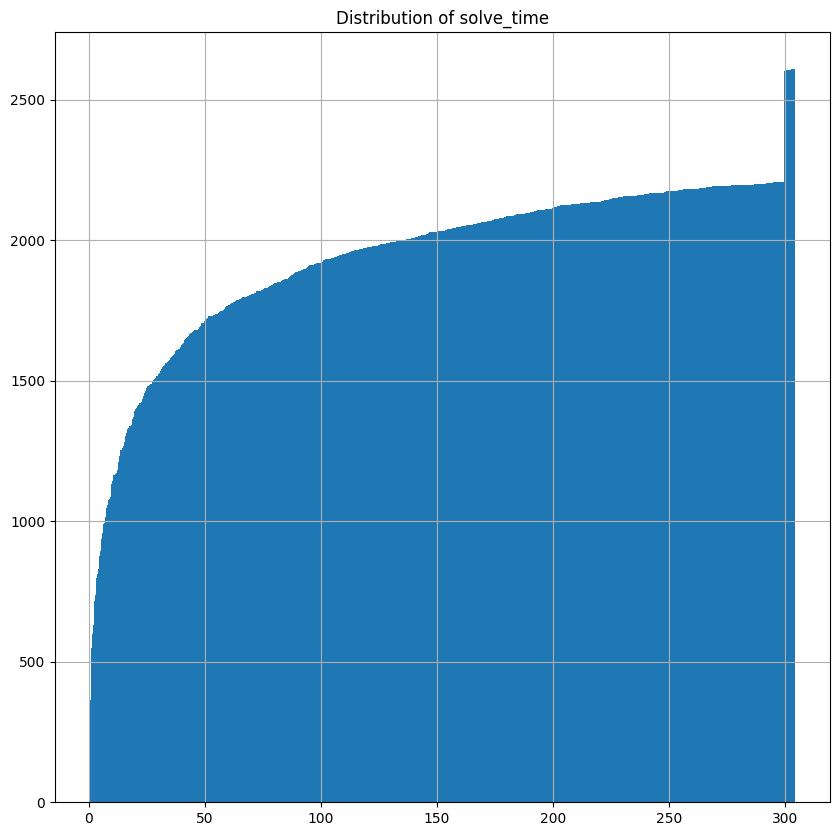

In [34]:
plt.figure(figsize=(10, 10))
plt.title("Distribution of solve_time")
vbs = df.sort_values("solve_time", ascending=False).groupby(["components", "nodes", "test"]).head(1)
vbs.solve_time.sort_values().hist(bins=1000, cumulative=True)

<Axes: title={'center': 'Distribution only for Optimal solutions'}>

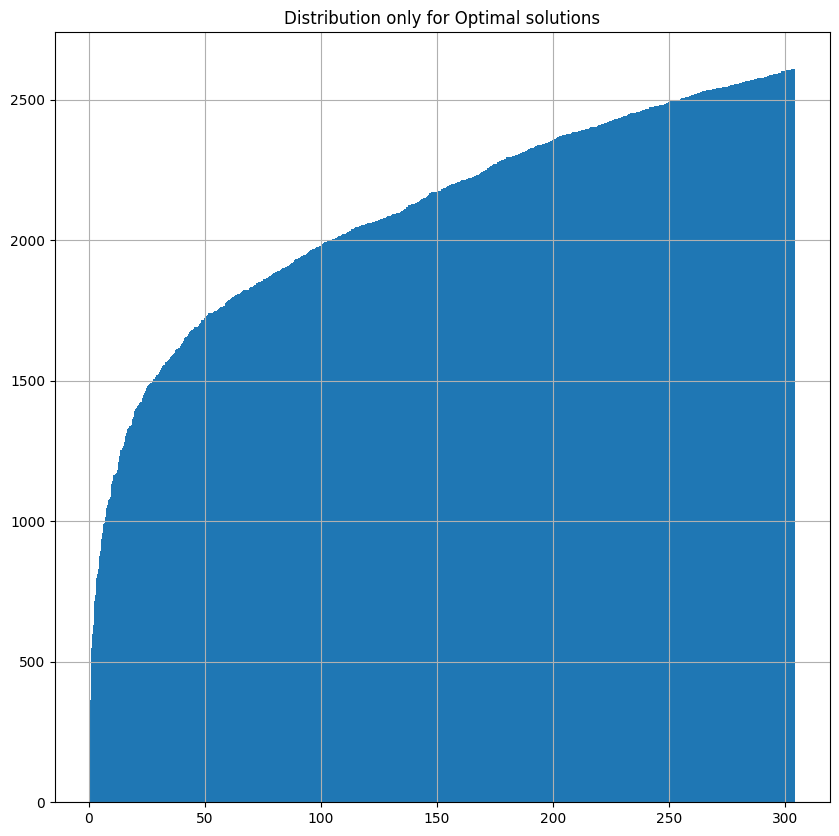

In [35]:
plt.figure(figsize=(10, 10))
plt.title("Distribution only for Optimal solutions")
vbs = df.query("status == 'Optimal solution'").sort_values("solve_time", ascending=False).groupby(["components", "nodes", "test"]).head(1)
vbs.solve_time.sort_values().hist(bins=1000, cumulative=True)

# Solve Time

### Components

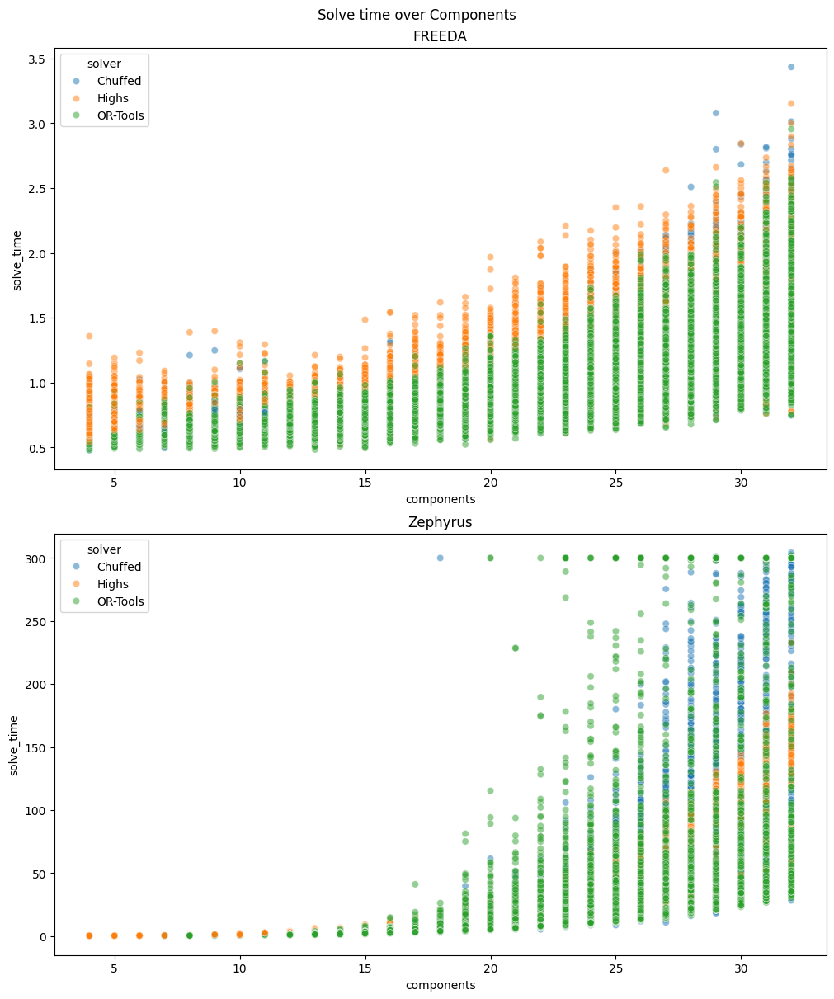

In [36]:
fig, axs = plt.subplots(len(models), 1, constrained_layout=True)
fig.suptitle("Solve time over Components")
fig.set_figheight(6 * len(models))
fig.set_figwidth(10)
for m, ax in zip(models, axs):
    ax.set_title(str(m))
    sns.scatterplot(
        data=df.query("model == @m"),
        x="components",
        y="solve_time",
        alpha=0.5,
        hue="solver",
        ax=ax
    )

### Nodes

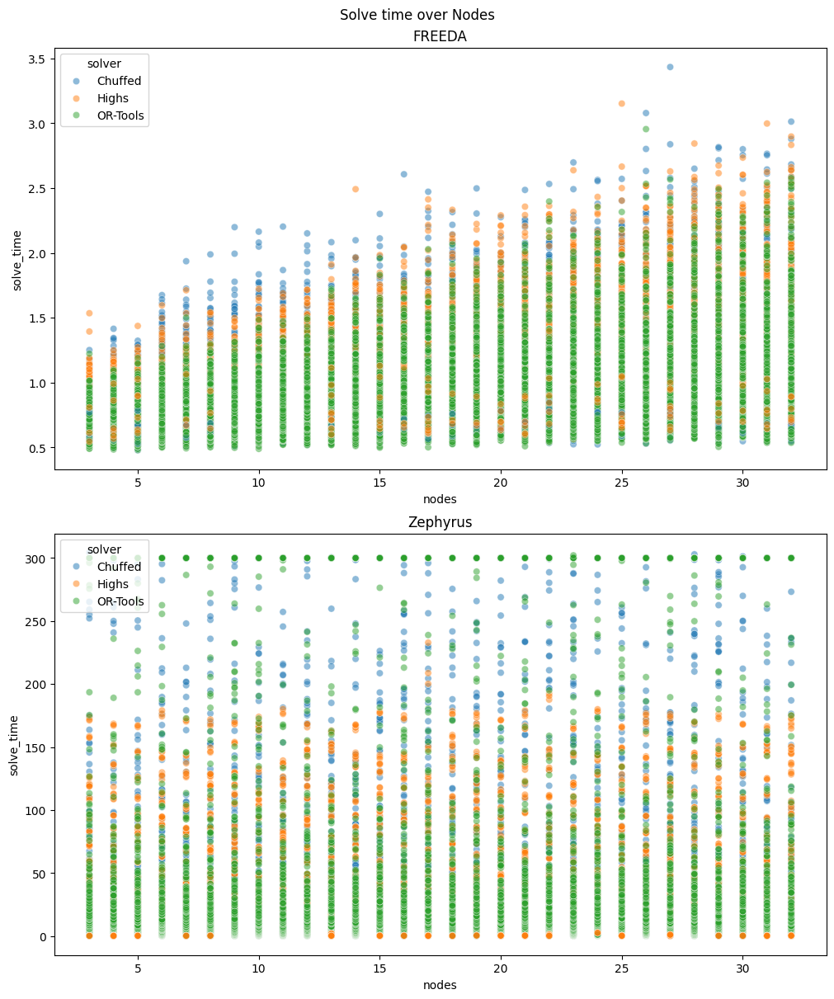

In [37]:
fig, axs = plt.subplots(len(models), 1, constrained_layout=True)
fig.suptitle("Solve time over Nodes")
fig.set_figheight(6 * len(models))
fig.set_figwidth(10)
for m, ax in zip(models, axs):
    ax.set_title(str(m))
    sns.scatterplot(
        data=df.query("model == @m"),
        x="nodes",
        y="solve_time",
        alpha=0.5,
        hue="solver",
        ax=ax
    )

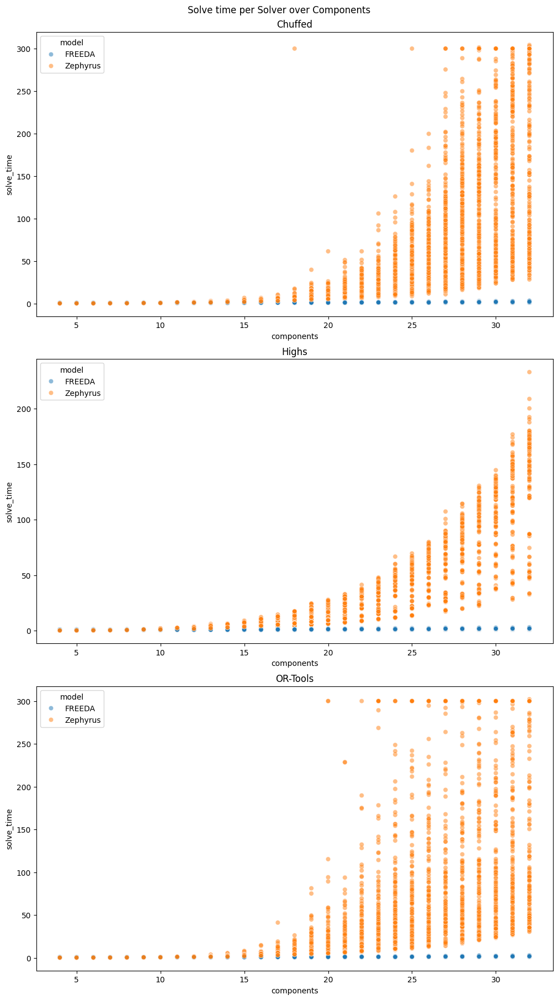

In [38]:
fig, axs = plt.subplots(len(solvers), 1, constrained_layout=True)
fig.suptitle("Solve time per Solver over Components")
fig.set_figheight(6 * len(solvers))
fig.set_figwidth(10)
for s, ax in zip(solvers, axs):
    ax.set_title(str(s))
    sns.scatterplot(
        data=df.query("solver == @s"),
        x="components",
        y="solve_time",
        alpha=0.5,
        hue="model",
        ax=ax
    )

### Components x nodes

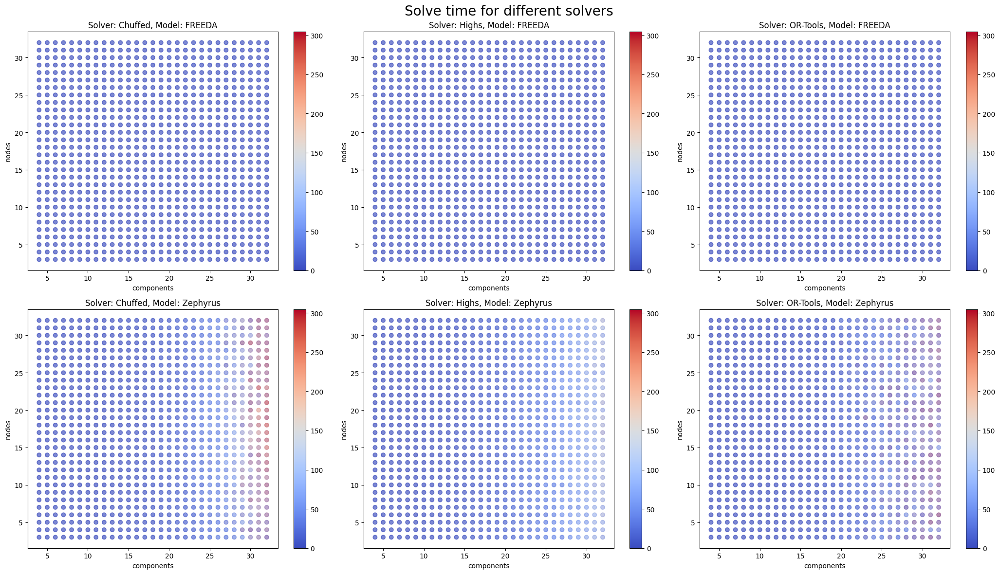

In [39]:
fig, axs = plt.subplots(
    nrows=len(models),
    ncols=len(solvers),
    figsize=(7 * len(solvers), 6 * len(models))
)
norm = Normalize(vmin=0, vmax=df.solve_time.max())
for m, ax_row in zip(models, axs):
    for s, ax in zip(solvers, ax_row):
        d = df.query("model == @m").query("solver == @s")
        ax.scatter(
            x=d.components,
            y=d.nodes,
            c=d.solve_time,
            cmap="coolwarm",
            norm=norm,
            alpha=1.0/(len(component_topologies) * 3)
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_title("Solver: " + s + ", Model: " + m)
        fig.colorbar(ScalarMappable(norm=norm, cmap="coolwarm"), ax=ax, orientation='vertical')

fig.suptitle("Solve time for different solvers", fontsize=20)
fig.tight_layout()

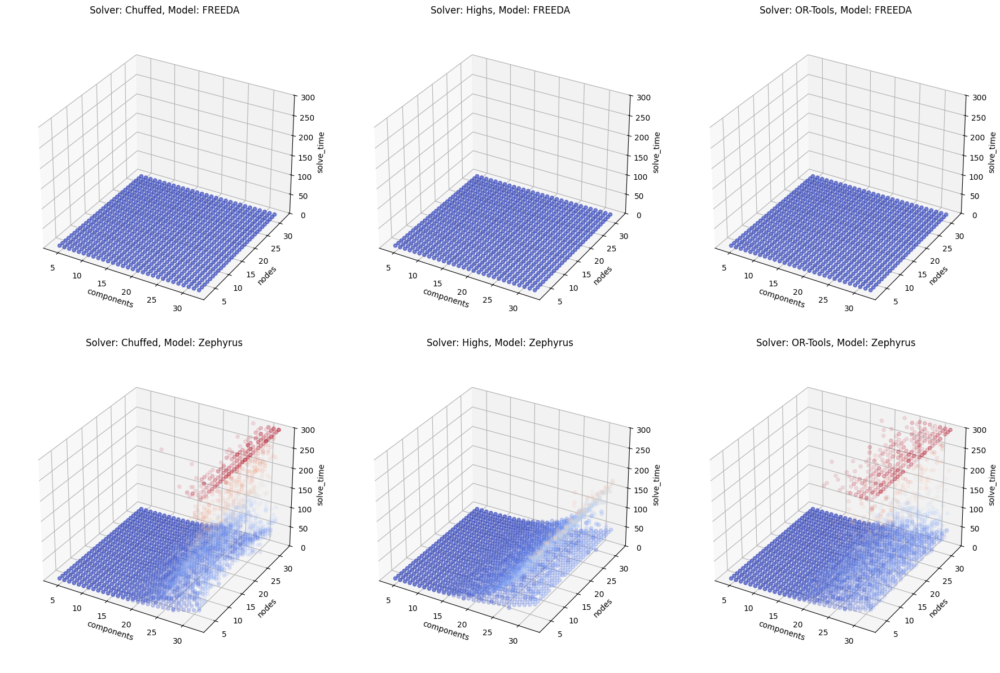

In [40]:
fig, axs = plt.subplots(
    nrows=len(models),
    ncols=len(solvers),
    figsize=(6 * len(solvers), 6 * len(models)),
    subplot_kw=dict(projection='3d')
)
norm = Normalize(vmin=0, vmax=df.solve_time.max())
for m, ax_row in zip(models, axs):
    for s, ax in zip(solvers, ax_row):
        d = df.query("model == @m").query("solver == @s")
        ax.scatter(
            xs=d.components,
            ys=d.nodes,
            zs=d.solve_time,
            c=d.solve_time,
            cmap="coolwarm",
            norm=norm,
            alpha=1.0/(len(component_topologies) * 3)
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_zlabel("solve_time")
        ax.set_title("Solver: " + s + ", Model: " + m)
        ax.set_box_aspect(None, zoom=0.90)
        ax.set_zlim([0, 300])

fig.tight_layout()

### Topologies

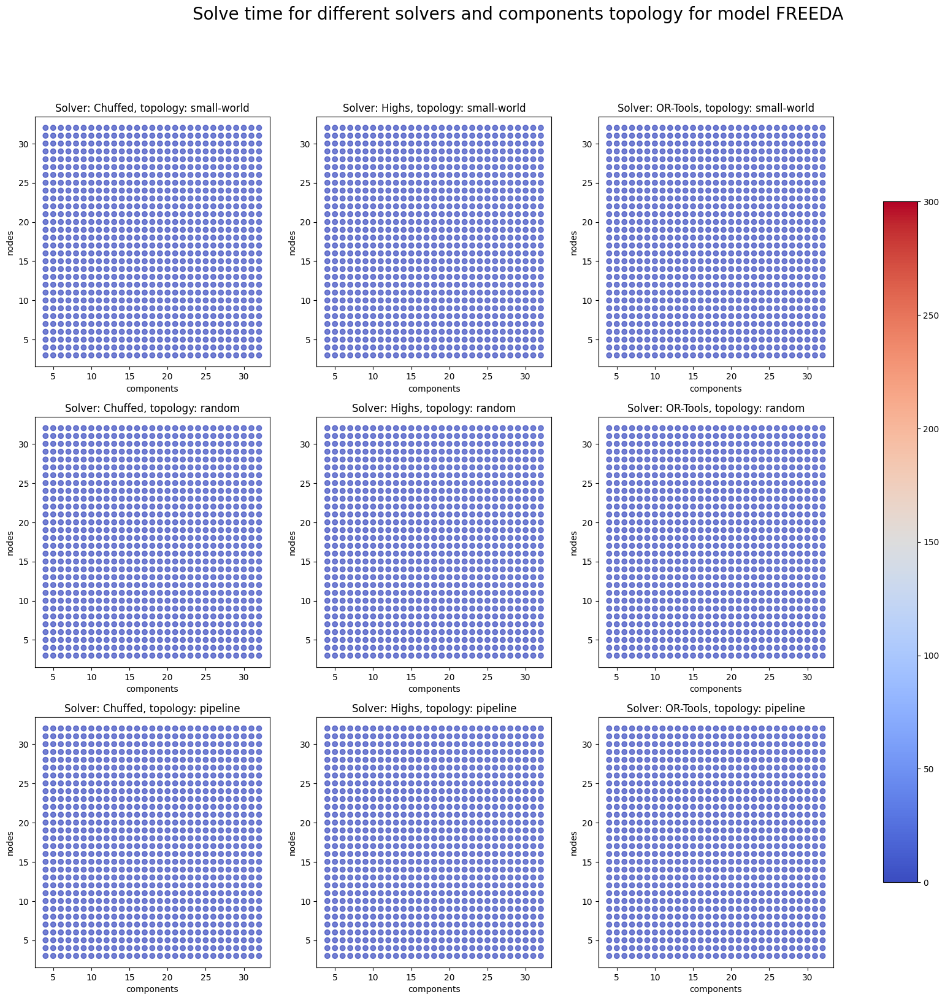

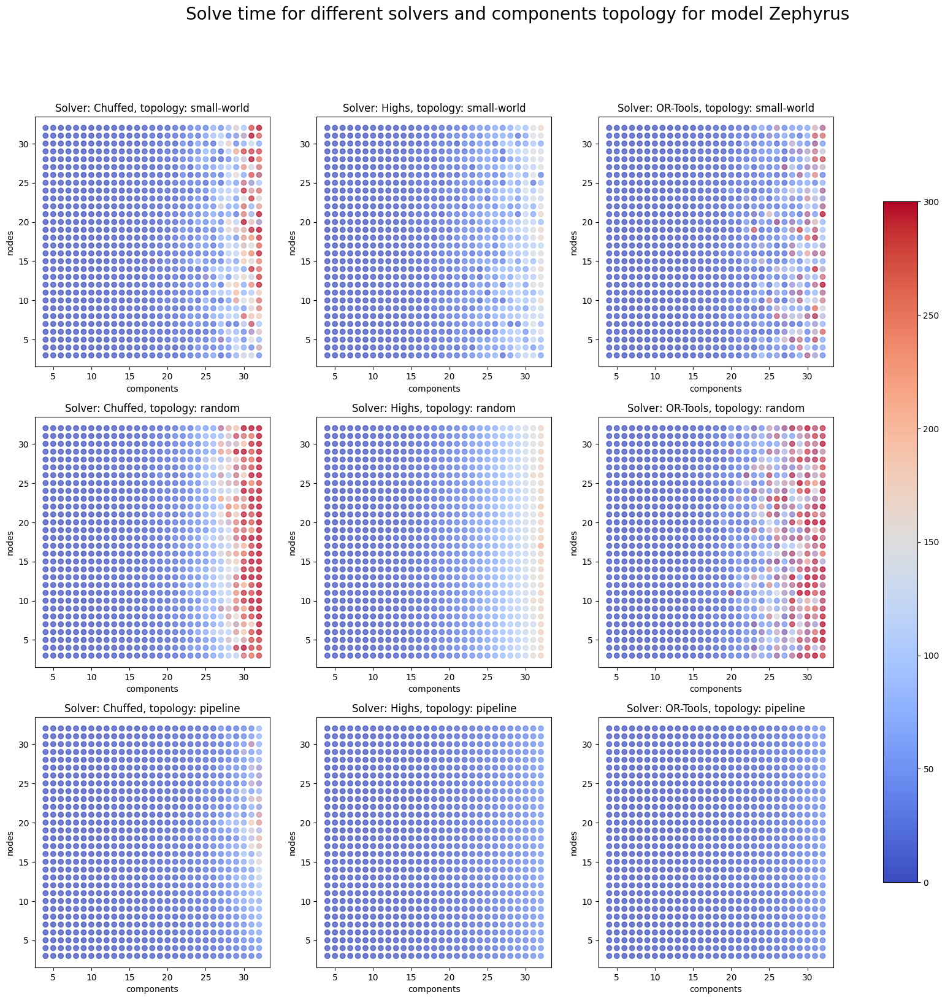

In [41]:
norm = Normalize(vmin=0, vmax=300)
for m in models:
    fig, axs = plt.subplots(
        nrows=len(component_topologies),
        ncols=len(solvers),
        figsize=(7 * len(component_topologies), 6 * len(solvers))
    )
    axs_reshaped = axs.reshape(-1)
    axis = itertools.product(component_topologies, solvers)
    df_model = df.query("model == @m")
    for (topology, solver), ax in zip(axis, axs_reshaped):
        d = df_model.query("solver == @solver").query("comps_topology == @topology")
        ax.scatter(
            x=d.components,
            y=d.nodes,
            c=d.solve_time,
            cmap="coolwarm",
            norm=norm,
            alpha=1.0/3
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_title("Solver: " + solver + ", topology: " + topology)

    fig.suptitle("Solve time for different solvers and components topology for model " + m, fontsize=20)
    fig.colorbar(
        ScalarMappable(norm=norm, cmap="coolwarm"),
        ax=axs.ravel().tolist(),
        orientation='vertical',
        shrink=0.8
    )

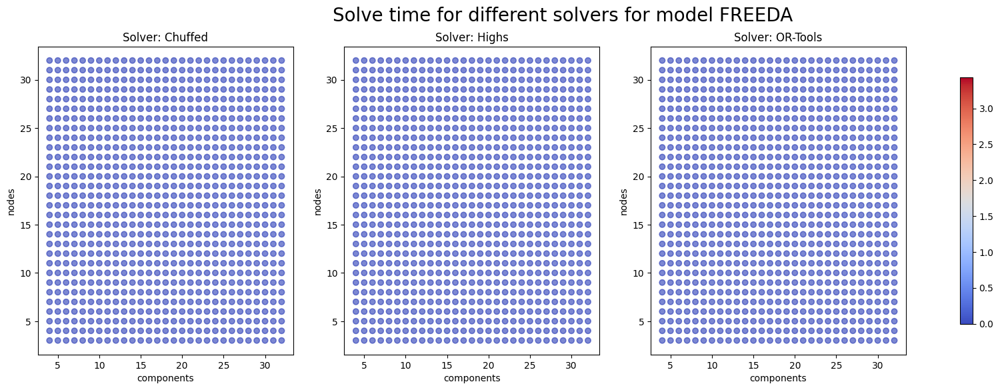

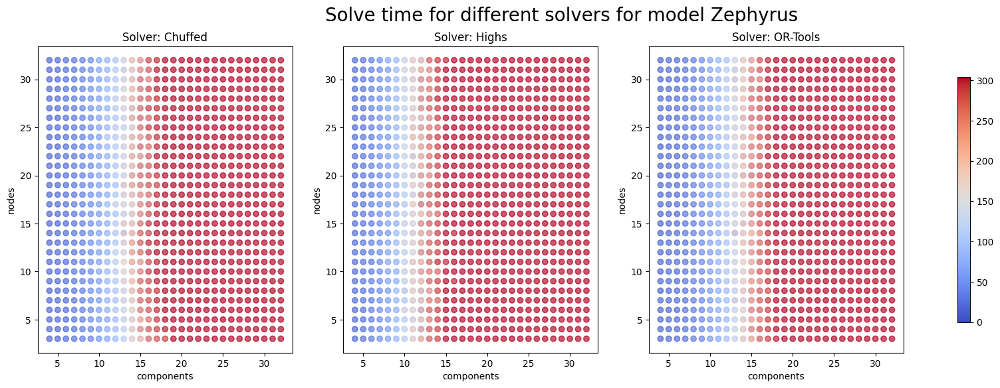

In [42]:
for m in models:
    fig, axs = plt.subplots(
        nrows=1,
        ncols=len(solvers),
        figsize=(7 * len(solvers), 6)
    )
    axs_reshaped = axs.reshape(-1)
    df_model = df.query("model == @m")
    for solver, ax in zip(solvers, axs_reshaped):
        d = df_model.query("solver == @solver")
        ax.scatter(
            x=d.components,
            y=d.nodes,
            c=d.solve_time,
            cmap="coolwarm",
            norm=norm,
            alpha=1.0/(len(component_topologies) * 3)
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_title("Solver: " + solver)

    norm = Normalize(vmin=0, vmax=df_model.solve_time.max())
    fig.colorbar(
        ScalarMappable(norm=norm, cmap="coolwarm"),
        ax=axs.ravel().tolist(),
        orientation='vertical',
        shrink=0.8
    )
    fig.suptitle("Solve time for different solvers for model " + m, fontsize=20)

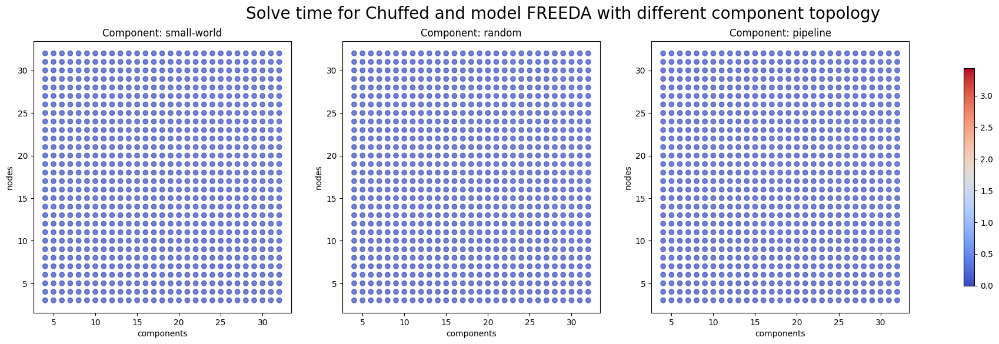

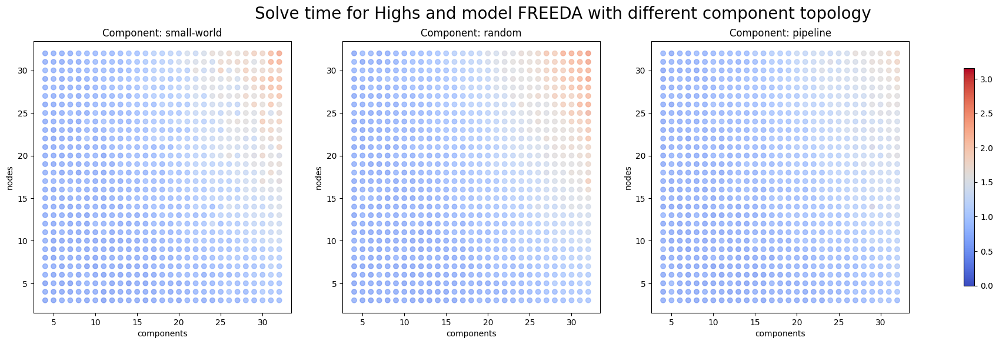

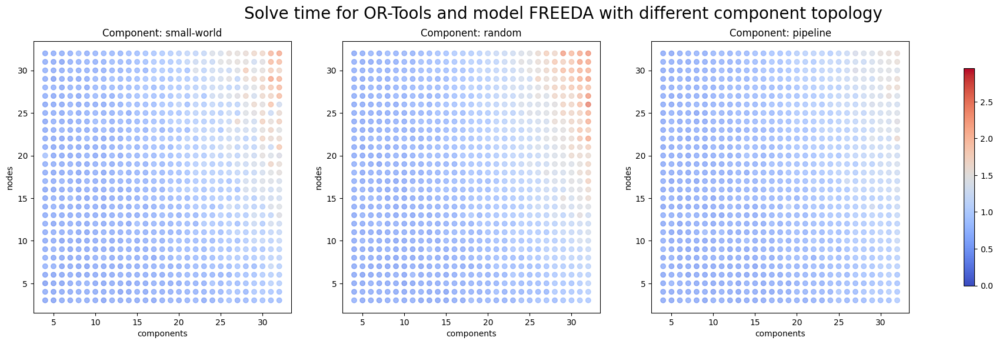

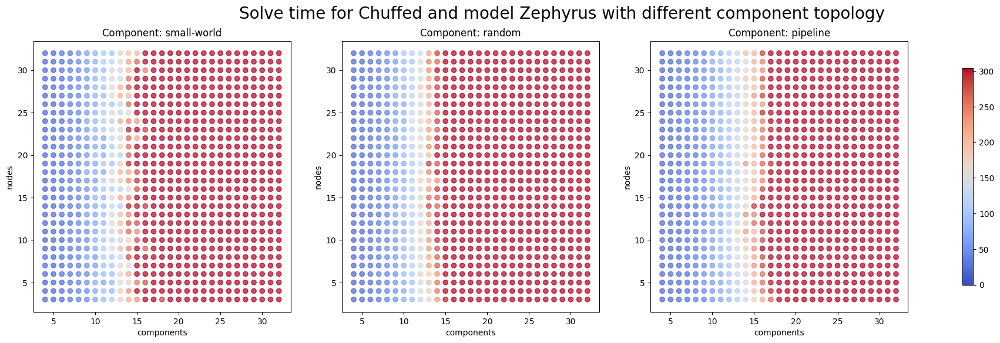

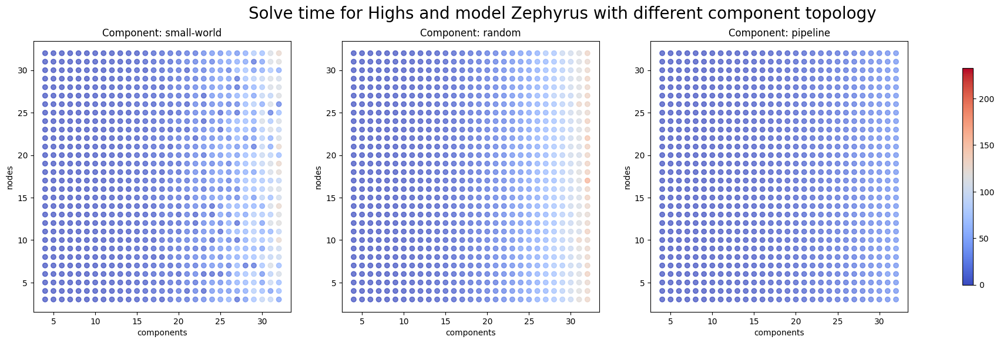

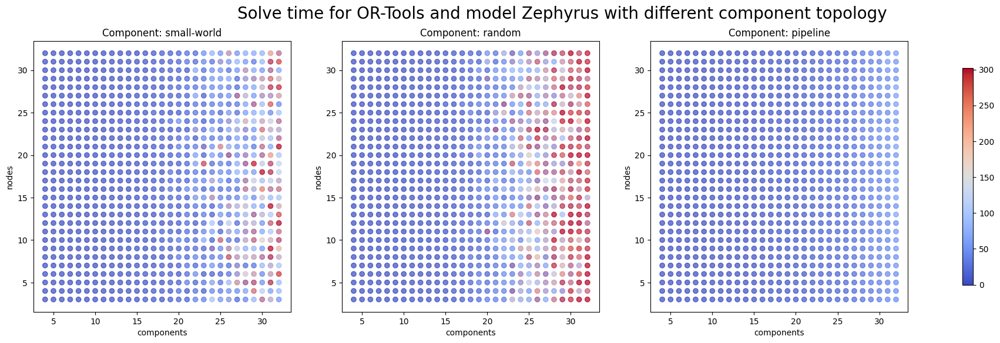

In [43]:
for m in models:
    for solver in solvers:
        fig, axs = plt.subplots(
            nrows=1,
            ncols=len(component_topologies),
            figsize=(8 * len(component_topologies), 6)
        )
        axs_reshaped = axs.reshape(-1)
        df_solver_problem = df.query("model == @m").query("solver == @solver")
        for comps_topology, ax in zip(component_topologies, axs_reshaped):
            d = df_solver_problem.query("comps_topology == @comps_topology")
            ax.scatter(
                x=d.components,
                y=d.nodes,
                c=d.solve_time,
                cmap="coolwarm",
                norm=norm,
                alpha=1.0/3
            )
            ax.set_xlabel("components")
            ax.set_ylabel("nodes")
            ax.set_title("Component: " + comps_topology)

        norm = Normalize(vmin=0, vmax=df_solver_problem.solve_time.max())
        fig.colorbar(
            ScalarMappable(norm=norm, cmap="coolwarm"),
            ax=axs.ravel().tolist(),
            orientation='vertical',
            shrink=0.8
        )
        fig.suptitle("Solve time for " + solver + " and model " + m + " with different component topology", fontsize=20)


# Flat time

### Components

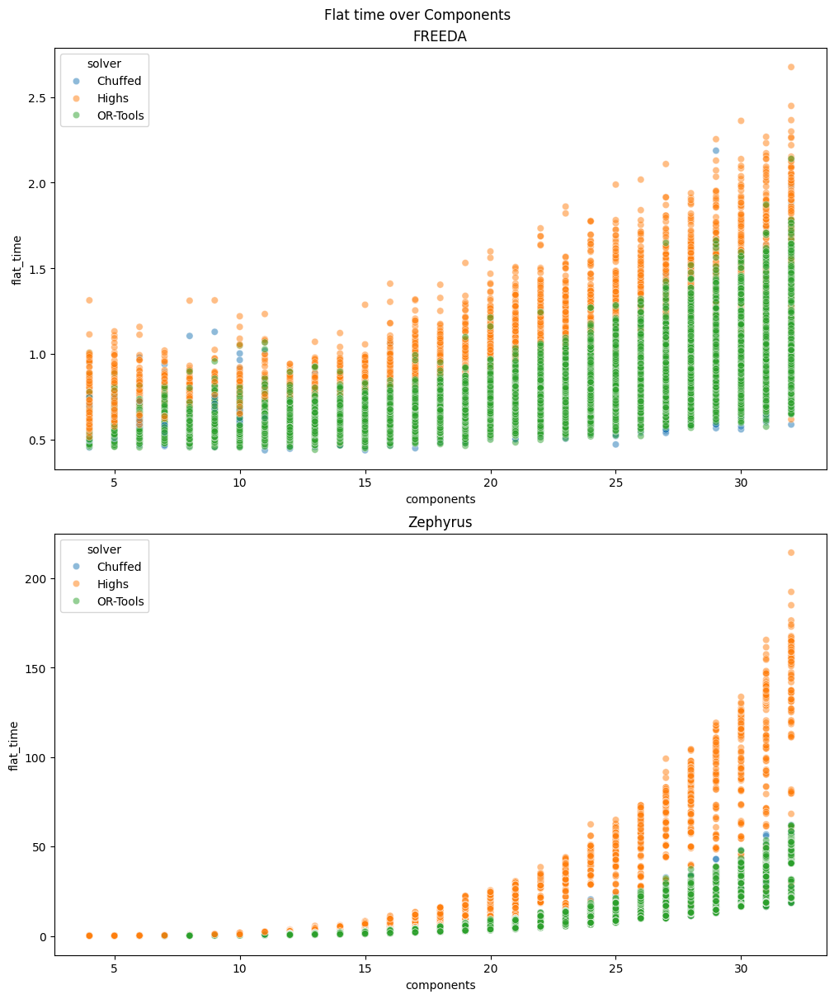

In [44]:
fig, axs = plt.subplots(len(models), 1, constrained_layout=True)
fig.suptitle("Flat time over Components")
fig.set_figheight(6 * len(models))
fig.set_figwidth(10)
for m, ax in zip(models, axs):
    ax.set_title(m)
    sns.scatterplot(
        data=df.query("model == @m"),
        x="components",
        y="flat_time",
        alpha=0.5,
        hue="solver",
        ax=ax
    )

### Nodes

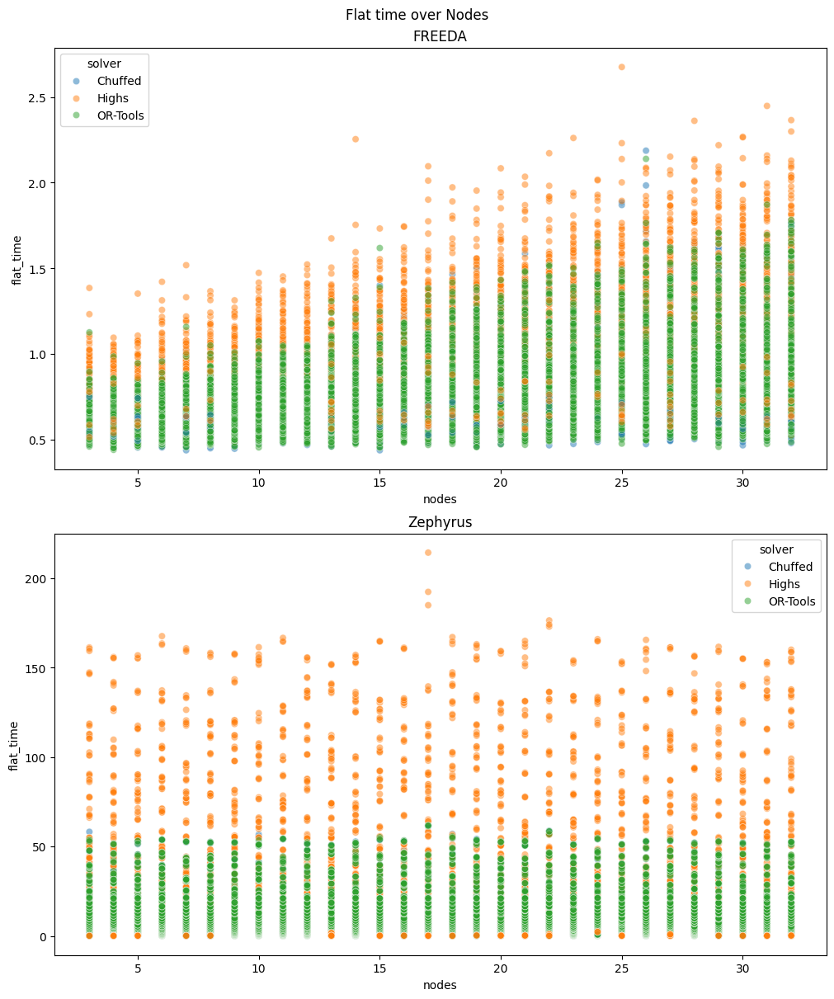

In [45]:
fig, axs = plt.subplots(len(models), 1, constrained_layout=True)
fig.suptitle("Flat time over Nodes")
fig.set_figheight(6 * len(models))
fig.set_figwidth(10)
for m, ax in zip(models, axs):
    ax.set_title(m)
    sns.scatterplot(
        data=df.query("model == @m"),
        x="nodes",
        y="flat_time",
        alpha=0.5,
        hue="solver",
        ax=ax
    )

### Components x nodes

Text(0.5, 0.98, 'Flat time for different solvers')

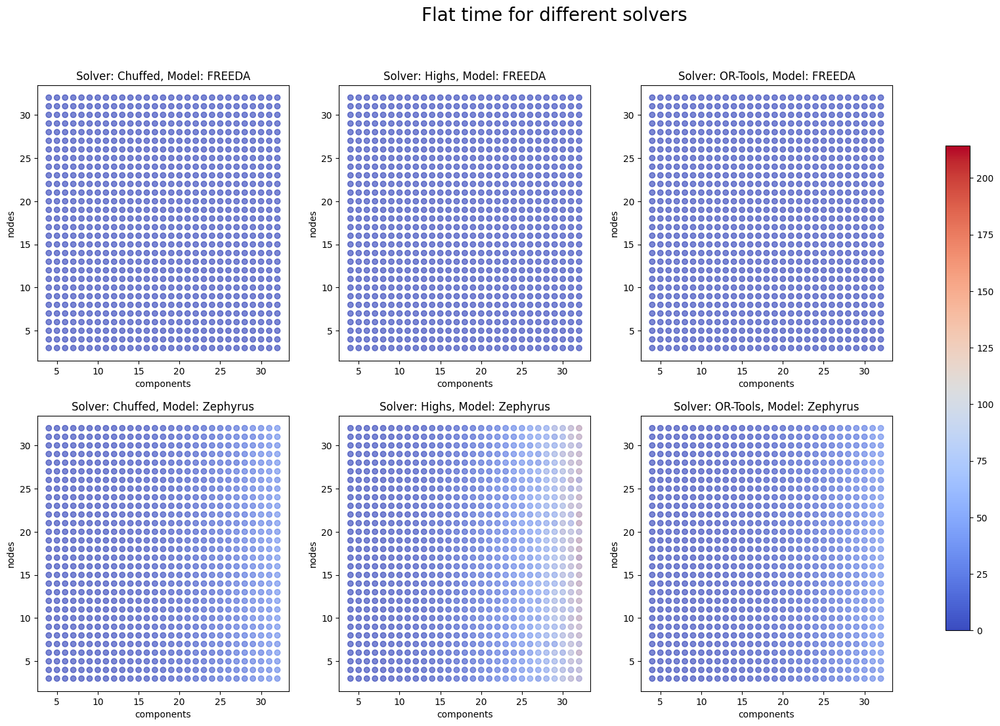

In [46]:
fig, axs = plt.subplots(
    nrows=len(models),
    ncols=len(solvers),
    figsize=(7 * len(solvers), 6 * len(models))
)
norm = Normalize(vmin=0, vmax=df.flat_time.max())
for m, ax_row in zip(models, axs):
    for s, ax in zip(solvers, ax_row):
        d = df.query("model == @m").query("solver == @s")
        ax.scatter(
            x=d.components,
            y=d.nodes,
            c=d.flat_time,
            cmap="coolwarm",
            norm=norm,
            alpha=1.0/(len(component_topologies) * 3)
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_title("Solver: " + s + ", Model: " + m)

fig.colorbar(
    ScalarMappable(norm=norm, cmap="coolwarm"),
    ax=axs.ravel().tolist(),
    orientation='vertical',
    shrink=0.8
)
fig.suptitle("Flat time for different solvers", fontsize=20)

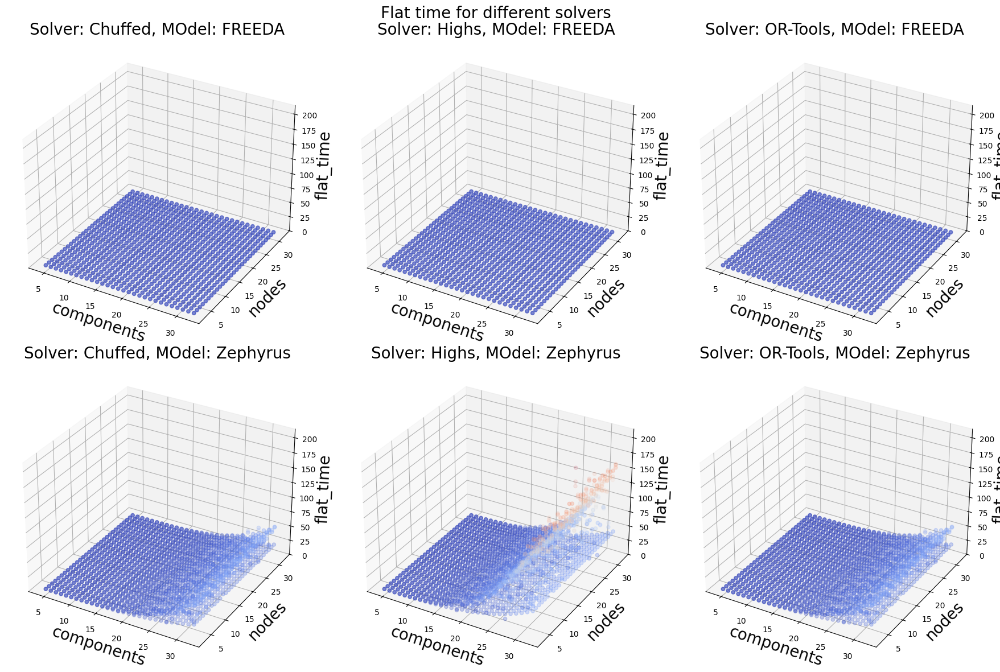

In [47]:
fig, axs = plt.subplots(
    nrows=len(models),
    ncols=len(solvers),
    figsize=(6 * len(solvers), 6 * len(models)),
    subplot_kw=dict(projection='3d')
)
norm = Normalize(vmin=0, vmax=df.flat_time.max())
for m, ax_row in zip(models, axs):
    for s, ax in zip(solvers, ax_row):
        d = df.query("model == @m").query("solver == @s")
        ax.scatter(
            xs=d.components,
            ys=d.nodes,
            zs=d.flat_time,
            c=d.flat_time,
            norm=norm,
            cmap="coolwarm",
            alpha=1.0/(len(component_topologies) * 3)
        )
        ax.set_zlim([0, df.flat_time.max()])
        ax.set_xlabel("components", fontsize=20)
        ax.set_ylabel("nodes", fontsize=20)
        ax.set_zlabel("flat_time", fontsize=20)
        ax.set_title("Solver: " + s + ", MOdel: " + m, fontsize=20)

fig.suptitle("Flat time for different solvers", fontsize=20)
fig.tight_layout()

### Topologies

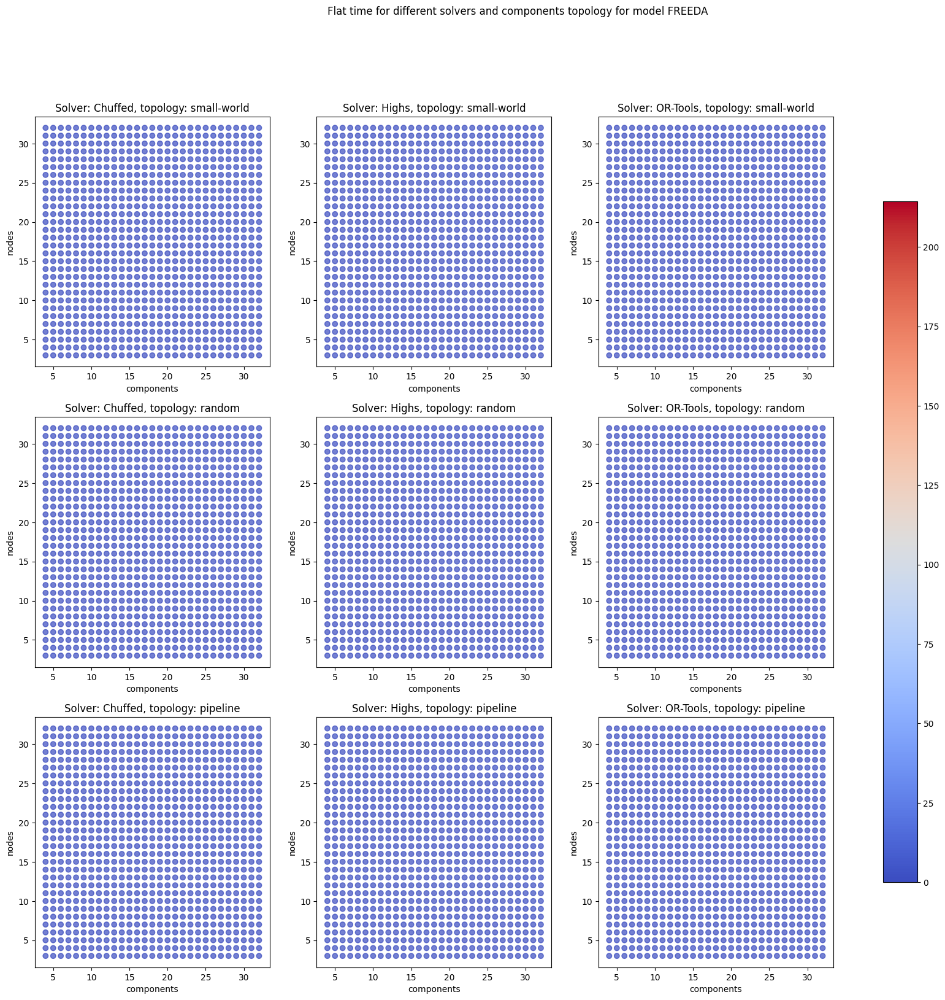

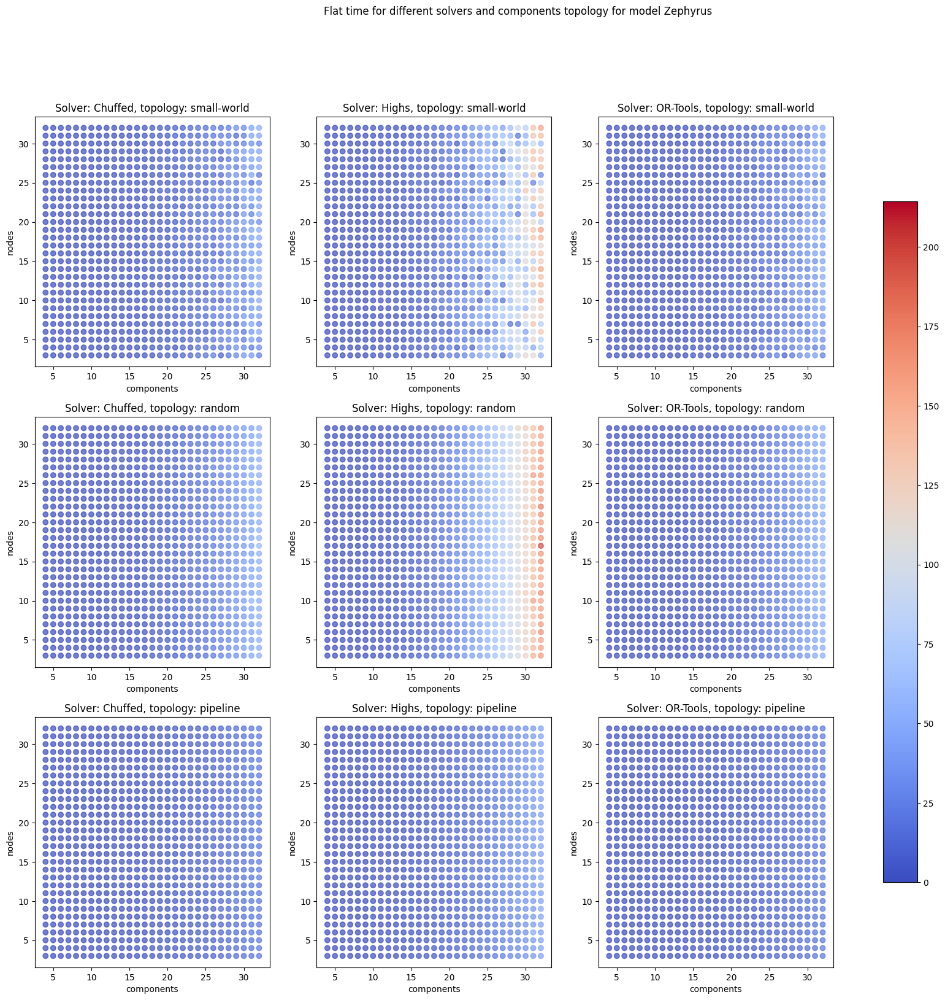

In [48]:
for m in models:
    fig, axs = plt.subplots(
        nrows=len(component_topologies),
        ncols=len(solvers),
        figsize=(7 * len(component_topologies), 6 * len(solvers))
    )
    axs_reshaped = axs.reshape(-1)
    axis = itertools.product(component_topologies, solvers)
    df_problem = df.query("model == @m")
    for (topology, solver), ax in zip(axis, axs_reshaped):
        d = df_problem.query("solver == @solver").query("comps_topology == @topology")
        ax.scatter(
            x=d.components,
            y=d.nodes,
            c=d.flat_time,
            cmap="coolwarm",
            norm=norm,
            alpha=1.0/3
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_title("Solver: " + solver + ", topology: " + topology)

    fig.suptitle("Flat time for different solvers and components topology for model " + m)
    fig.colorbar(
        ScalarMappable(norm=norm, cmap="coolwarm"),
        ax=axs.ravel().tolist(),
        orientation='vertical',
        shrink=0.8
    )

# Flat time vs Solve time

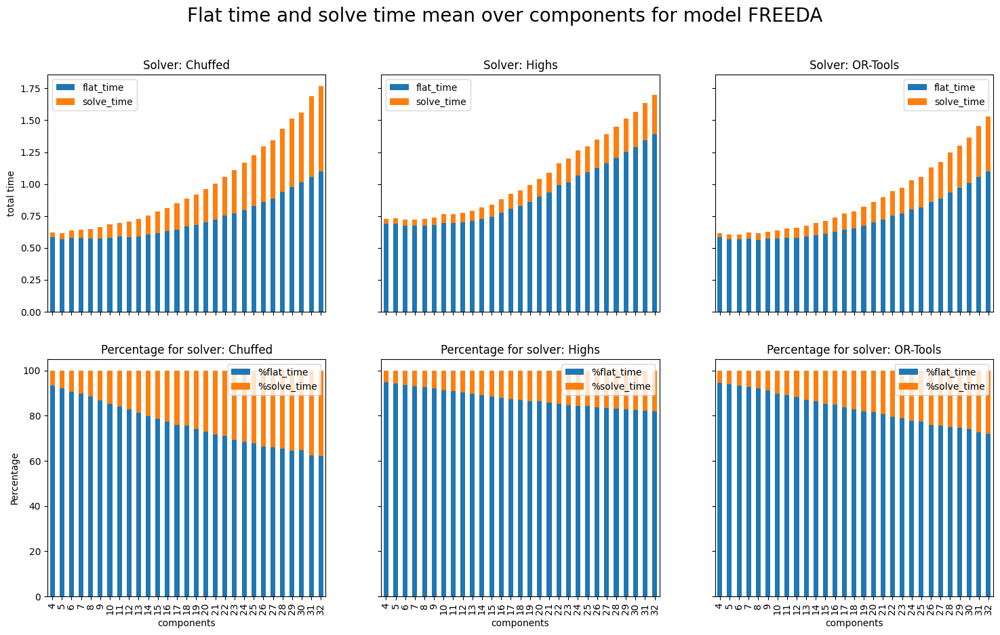

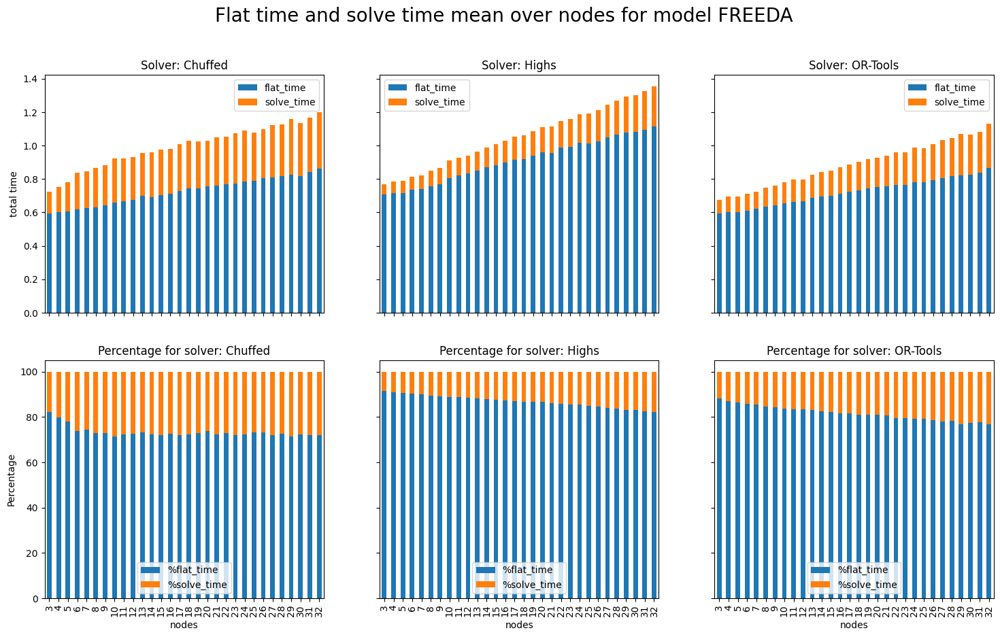

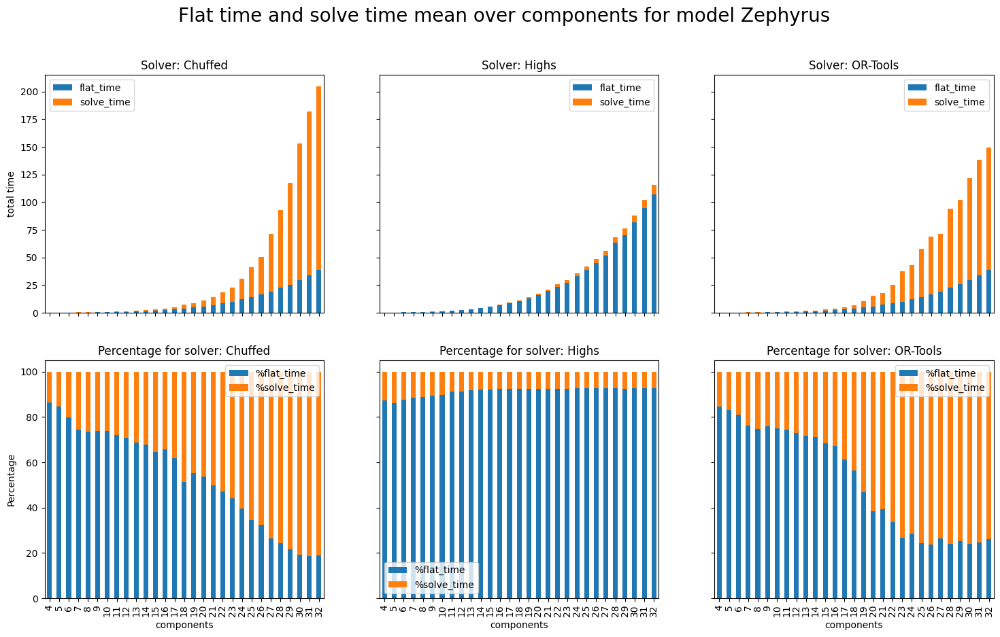

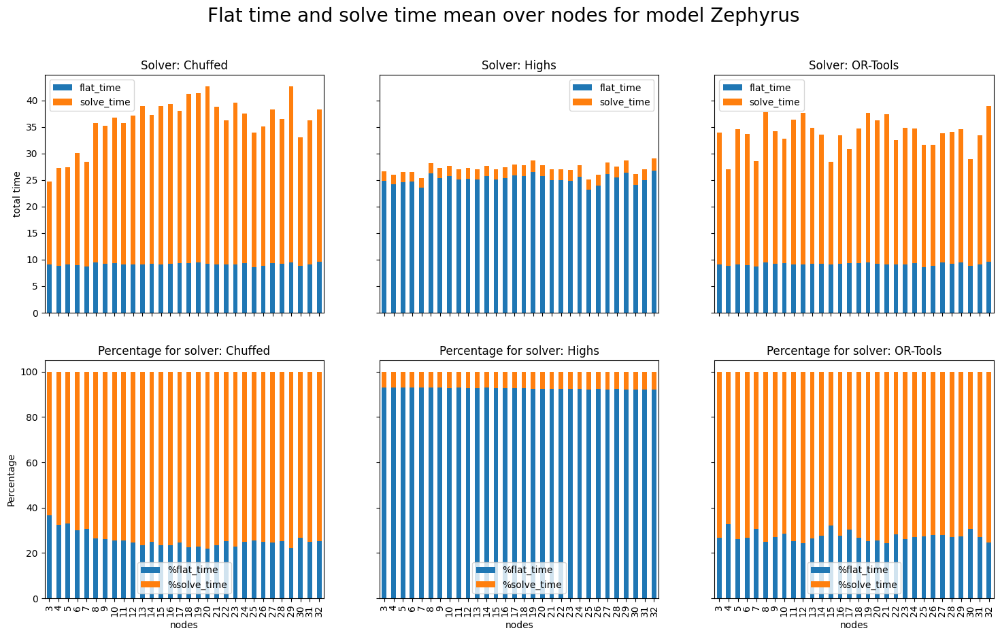

In [49]:
for m in models:
    for over in ["components", "nodes"]:
        fig, axs = plt.subplots(
            nrows=2,
            ncols=len(solvers),
            figsize=(6 * len(solvers), 10),
            sharex=True,
            sharey="row"
        )
        axs_reshaped = axs.reshape(-1)

        for solver, (i, ax) in zip(solvers, enumerate(axs_reshaped)):
            times = (
                df
                .query("solver == @solver")
                .query("model == @m")
                .assign(**{
                    "solve_time" : lambda df : df["solve_time"] - df["flat_time"]
                })
                .groupby(over)
                [["flat_time", "solve_time"]]
                .mean()
            )

            times.plot.bar(
                ax=ax,
                stacked=True,
                title="Solver: " + solver,
            )
            ax.set_ylabel("total time")

            times.assign(**{
                "%flat_time" : lambda df : (df["flat_time"] / (df["flat_time"] + df["solve_time"])) * 100,
                "%solve_time" : lambda df : (df["solve_time"] / (df["flat_time"] + df["solve_time"])) * 100
            }).drop(
                columns=["solve_time", "flat_time"]
            ).plot.bar(
                stacked=True,
                title="Percentage for solver: " + solver,
                ax=axs_reshaped[len(solvers) + i],
            )
            axs_reshaped[len(solvers) + i].set_ylabel("Percentage")

        fig.suptitle("Flat time and solve time mean over " + over + " for model " + m, fontsize=20)
        plt.show()


# Paper images and tables

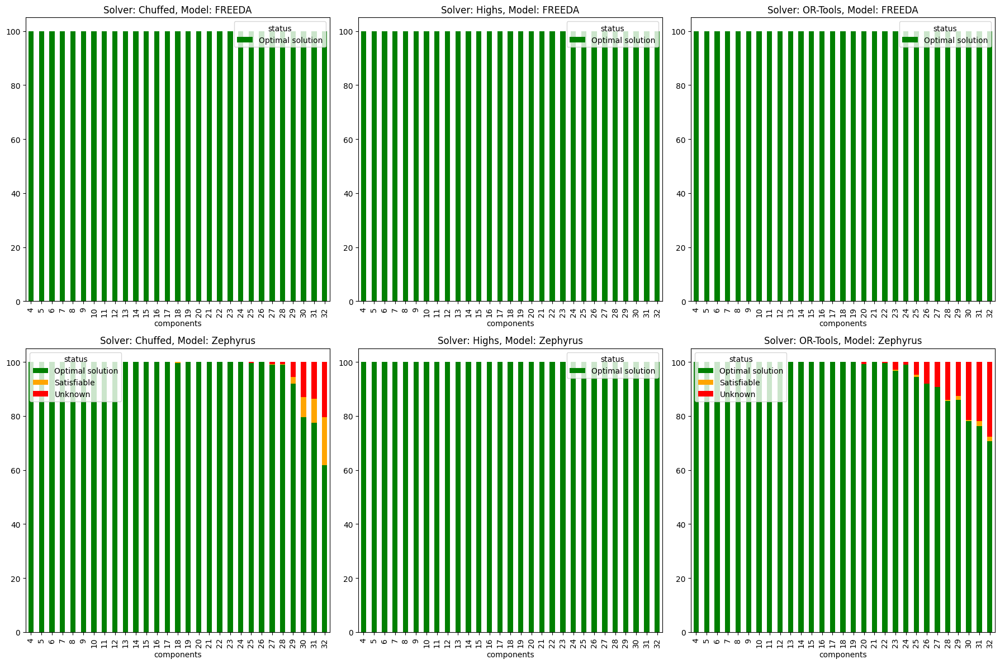

In [50]:
colors = {
    "Optimal solution": "green",
    "Unsatisfiable": "#1f77b4",
    "Unknown": "red",
    "Satisfiable" : "orange"
}
fig, axs = plt.subplots(
    nrows=2,
    ncols=len(solvers),
    figsize=(6 * len(solvers), 12)
)
norm = Normalize(vmin=0, vmax=100)
for model, ax_row in zip(models, axs):
    for solver, ax in zip(solvers, ax_row):
        d = (
            df.query("solver == @solver")
            .query("model == @model")
            [["components", "status"]]
            .groupby("components")
            .value_counts(normalize=True)
            * 100
        ).reset_index().pivot(
            index="components",
            columns="status",
            values="proportion"
        ).fillna(0)

        d.plot.bar(
            color=colors,
            stacked=True,
            ax=ax,
            title="Solver: " + solver + ", Model: " + model
        )

fig.tight_layout()
plt.show()

Text(0, 0.5, 'solve time difference')

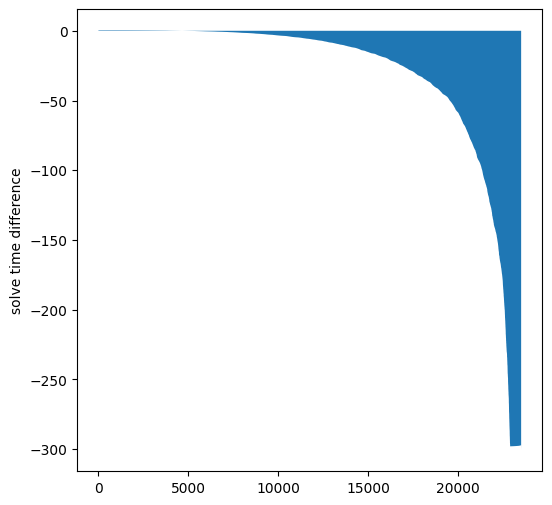

In [51]:
fig, ax = plt.subplots(1, 1, figsize=(6, 6))

area_plot = (
    df.query("model == 'FREEDA'").solve_time.sort_values().reset_index(drop=True)
    -
    df.query("model == 'Zephyrus'").solve_time.sort_values().reset_index(drop=True)
).reset_index()

ax.fill_between(area_plot.index, area_plot.solve_time)
ax.set_xlabel("")
ax.set_ylabel("solve time difference")

In [52]:
save_fig(fig, "solve-time-diff-zeph")

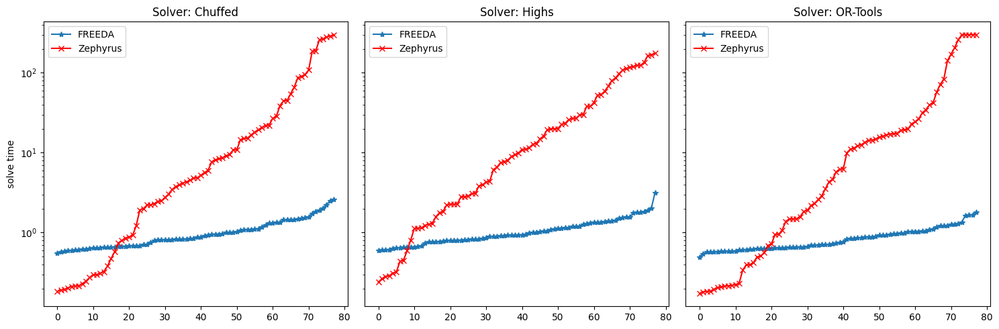

In [69]:
fig, axs = plt.subplots(
    nrows=1,
    ncols=len(solvers),
    sharex=True,
    sharey=True,
    figsize=(15, 5),
)

for solver, ax in zip(solvers, axs):
    for model in models:
        d = (
            df.query("solver == @solver")
            .query("model == @model")
            .solve_time
            .sample(frac=0.01)
            .sort_values(ascending=True)
            .reset_index(drop=True)
            .reset_index()
        )
        ax.plot(
            d.index,
            d.solve_time,
            marker=marker_model[model],
            c=color_model[model],
            label=model
        )
        ax.set_title("Solver: " + solver)
        ax.set_yscale('log')
        ax.set_xlabel("")
        ax.legend()

axs[0].set_ylabel("solve time")
fig.tight_layout()

In [54]:
save_fig(fig, "solve-time-log-zeph")

In [55]:
mean_solve_time = (
    df[["model", "solver", "solve_time"]]
    .groupby(["model", "solver"])
    .aggregate("mean")
    .rename(columns={"solve_time" : "avg"})
    .map(lambda x : str(round(x, 2)) + "s")
)
mean_solve_time

avg
model    solver          
FREEDA   Chuffed    0.99s
         Highs      1.05s
         OR-Tools   0.89s
Zephyrus Chuffed    36.1s
         Highs     27.21s
         OR-Tools  33.77s

In [56]:
mean_opt_solve_time = (
    df
    .query("status == 'Optimal solution'")
    [["model", "solver", "solve_time"]]
    .groupby(["model", "solver"])
    .aggregate("mean")
    .rename(columns={"solve_time" : "avg opt"})
    .map(lambda x : str(round(x, 2)) + "s")
)
mean_opt_solve_time

avg opt
model    solver          
FREEDA   Chuffed    0.99s
         Highs      1.05s
         OR-Tools   0.89s
Zephyrus Chuffed   27.43s
         Highs     27.21s
         OR-Tools  21.09s

In [57]:
perc = (
    df[["model", "solver", "status"]]
    .groupby(["model", "solver"])
    .aggregate(lambda x : str(round((
        len(x[x.str.contains("Optimal solution") | x.str.contains("Unsatisfiable")]) / len(x)) * 100,
        2)) + "%")
    .rename(columns={"status" : "complete"})
)
perc

complete
model    solver           
FREEDA   Chuffed    100.0%
         Highs      100.0%
         OR-Tools   100.0%
Zephyrus Chuffed    96.82%
         Highs      100.0%
         OR-Tools   95.45%

In [58]:
scores_df = (
    pd.concat(scores)
    [["model", "solver", "score"]]
    .groupby(["model", "solver"])
    .sum()
    .map(lambda x : round(x, 2))
)
scores_df

score
model    solver            
FREEDA   Chuffed   27816.74
         Highs     27079.24
         OR-Tools  29263.84
Zephyrus Chuffed   11859.41
         Highs      9041.60
         OR-Tools  12327.17

In [59]:
min_max = (
    df[["model", "solve_time", "solver"]]
    .groupby(["model", "solver"])
    .aggregate(["min", "max"])
    .map(lambda x : str(round(x, 2)) + "s")
)
min_max.columns = min_max.columns.droplevel()
min_max

min      max
model    solver                  
FREEDA   Chuffed   0.48s    3.43s
         Highs     0.53s    3.15s
         OR-Tools  0.48s    2.96s
Zephyrus Chuffed   0.15s  304.27s
         Highs     0.19s  232.86s
         OR-Tools  0.16s  302.13s

In [60]:
flat = (
    df[["model", "flat_time", "solver"]]
    .groupby(["model", "solver"])
    .aggregate("mean")
    .rename(columns={"flat_time" : "flat"})
    #.unstack()
    .map(lambda x : str(round(x, 2)) + "s")
)
flat

flat
model    solver          
FREEDA   Chuffed    0.73s
         Highs      0.91s
         OR-Tools   0.72s
Zephyrus Chuffed    9.15s
         Highs     25.19s
         OR-Tools   9.16s

In [61]:
first_last = (
    df
    .query("status == 'Optimal solution' or status == 'Satisfiable'")
    [["model", "objectives", "solver"]]
    .assign(**{
        "first" : lambda df : df.objectives.apply(lambda d : min(float(t) for t in d.keys())),
        "last" : lambda df : df.objectives.apply(lambda d : max(float(t) for t in d.keys()))
    }).drop(columns=["objectives"])
    .groupby(["model", "solver"])
    .aggregate("mean")
    .map(lambda x : str(round(x, 2)) + "s")
)
first_last

first    last
model    solver                  
FREEDA   Chuffed    0.84s   0.99s
         Highs      1.02s   1.02s
         OR-Tools   0.81s   0.86s
Zephyrus Chuffed   22.69s  30.78s
         Highs     26.89s  27.09s
         OR-Tools  19.43s   21.4s

In [62]:
print(
    pd.concat([
        mean_solve_time,
        mean_opt_solve_time,
        min_max,
        perc,
        flat,
        first_last,
        scores_df,
    ], axis=1)
    .sort_values("score", ascending=False)
    #.reset_index()
    .to_latex(multicolumn=False, escape=True, multirow=False, float_format="%.2f")
)

\begin{tabular}{llllllllllr}
\toprule
 &  & avg & avg opt & min & max & complete & flat & first & last & score \\
model & solver &  &  &  &  &  &  &  &  &  \\
\midrule
FREEDA & OR-Tools & 0.89s & 0.89s & 0.48s & 2.96s & 100.0\% & 0.72s & 0.81s & 0.86s & 29263.84 \\
 & Chuffed & 0.99s & 0.99s & 0.48s & 3.43s & 100.0\% & 0.73s & 0.84s & 0.99s & 27816.74 \\
 & Highs & 1.05s & 1.05s & 0.53s & 3.15s & 100.0\% & 0.91s & 1.02s & 1.02s & 27079.24 \\
Zephyrus & OR-Tools & 33.77s & 21.09s & 0.16s & 302.13s & 95.45\% & 9.16s & 19.43s & 21.4s & 12327.17 \\
 & Chuffed & 36.1s & 27.43s & 0.15s & 304.27s & 96.82\% & 9.15s & 22.69s & 30.78s & 11859.41 \\
 & Highs & 27.21s & 27.21s & 0.19s & 232.86s & 100.0\% & 25.19s & 26.89s & 27.09s & 9041.60 \\
\bottomrule
\end{tabular}



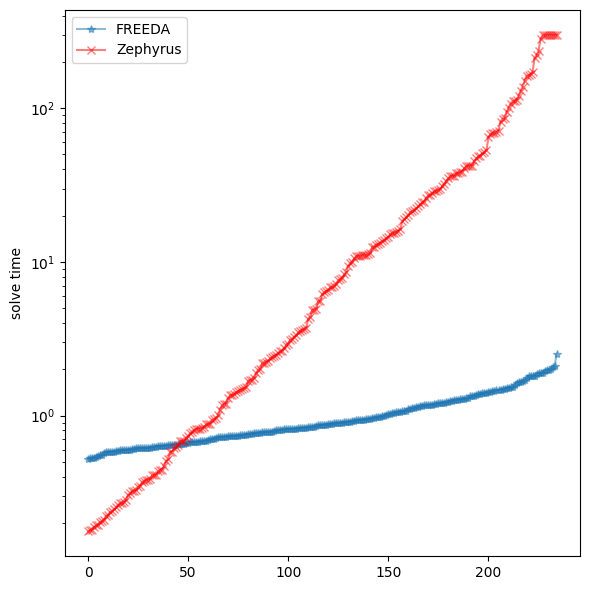

In [63]:
fig, ax = plt.subplots(
    nrows=1,
    ncols=1,
    figsize=(6, 6),
)

for model in models:
    (
        df
        .query("model == @model")
        .sample(frac=0.01)
        .solve_time
        .sort_values(ascending=True)
        .reset_index(drop=True).reset_index()
        .plot.line(
            x="index",
            y="solve_time",
            ax=ax,
            marker=marker_model[model],
            alpha=0.5,
            ms=6,
            linestyle="-",
            color=color_model[model],
            label=model
        )
    )
    ax.set_yscale('log')
    ax.set_ylabel("solve time")
    ax.set_xlabel("")

fig.tight_layout()

In [64]:
save_fig(fig, "solve-time-distrib-zeph")

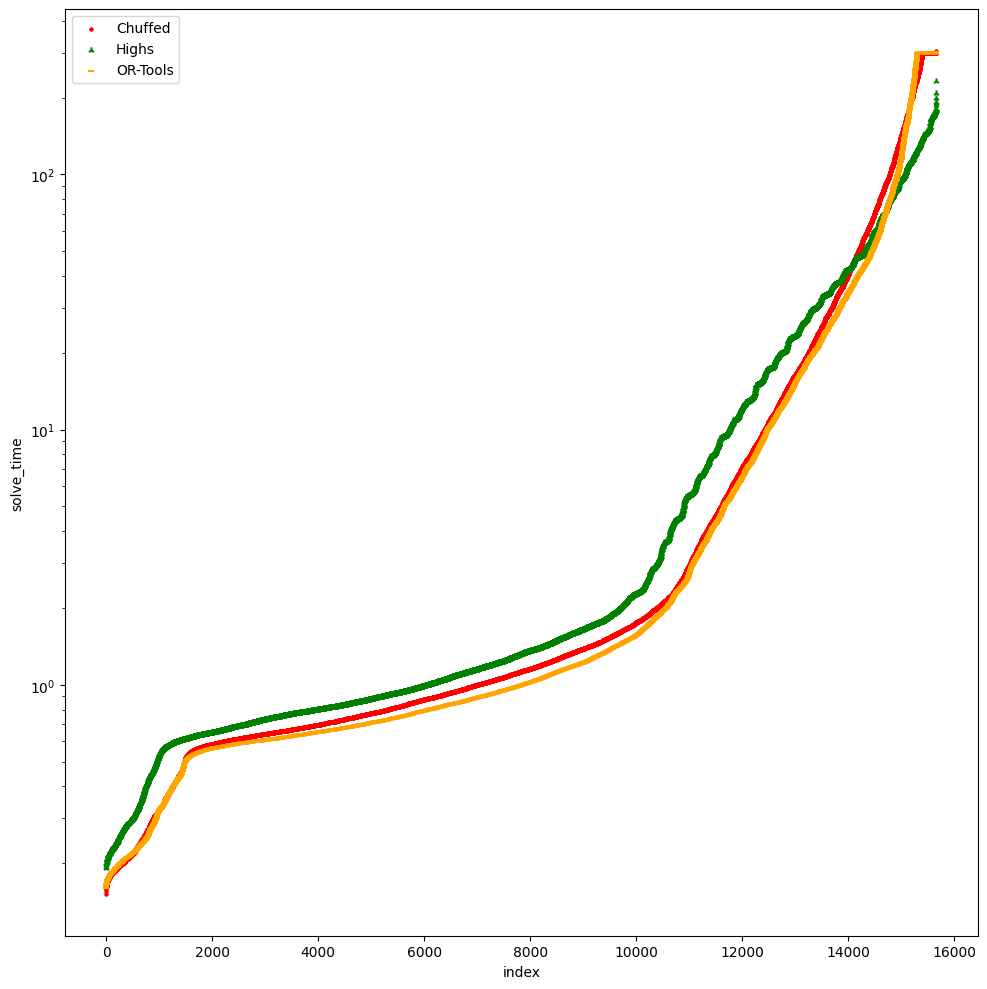

In [65]:
fig, ax = plt.subplots(
    nrows=1,
    ncols=1,
    figsize=(10, 10),
)

for solver in solvers:
    d = df.query("solver == @solver").solve_time.sort_values(ascending=True).reset_index(drop=True).reset_index()
    d.plot.scatter(x="index", y="solve_time", ax=ax, c=color[solver], marker=marker[solver], label=solver)

ax.set_yscale("log")
ax.legend()
fig.tight_layout()